In [1]:
!pip install git+https://github.com/KindXiaoming/pykan.git

  Cloning https://github.com/KindXiaoming/pykan.git to /tmp/pip-req-build-n6k40wkg
  Running command git clone --filter=blob:none --quiet https://github.com/KindXiaoming/pykan.git /tmp/pip-req-build-n6k40wkg
  Resolved https://github.com/KindXiaoming/pykan.git to commit 27b4640aeee010dabb34264e6c7d7272bcf130f8
  Preparing metadata (setup.py) ... done
  Created wheel for pykan: filename=pykan-0.0.5-py3-none-any.whl size=34114 sha256=64494a4df8b60a44cee3970f76e69ff65ae6b0b0637ad31aff1608910e119fff
  Stored in directory: /tmp/pip-ephem-wheel-cache-naw2tv7e/wheels/47/ca/5a/98124e020f3119f51c17f78738c621c140b7aa803b0feda76e
Successfully built pykan


In [2]:
import torch
from kan.spline import curve2coef, coef2curve, B_batch
from kan.KAN import KAN
from torch import nn

import numpy as np
from tqdm import tqdm

import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset

from PIL import Image
from torchvision.transforms import Resize, Compose, ToTensor, Normalize
import skimage
import matplotlib.pyplot as plt

import time

## SIREN layer

In [3]:
class SineLayer(nn.Module):
    def __init__(self, w0):
        super(SineLayer, self).__init__()
        self.w0 = w0
    def forward(self, x):
        return torch.sin(self.w0 * x)

## LAN layer

In [4]:
class LAN_layer(nn.Module):
    def __init__(
        self,
        dim=2,
        num=5,
        k=3,
        noise_scale=0.1,
        scale_base=1.0,
        scale_sp=1.0,
        base_fun=torch.nn.SiLU(), # тут другая базовая функция!
        grid_eps=0.02,
        grid_range=[-1,1],
        sp_trainable=True,
        sb_trainable=True,
        device='cpu'
    ):
        super().__init__()

        self.dim = dim
        self.num = num
        self.k = k 
        self.base_fun = base_fun
        self.device = device

        self.scale_base = scale_base
        self.scale_sp = scale_sp

        # определить grid
        self.grid = torch.einsum('i,j->ij', torch.ones(self.dim, device=device), torch.linspace(grid_range[0], grid_range[1], steps=num + 1, device=device)) # (dim, grid)
        self.grid = torch.nn.Parameter(self.grid).requires_grad_(False)

        noises = (torch.rand(self.dim, self.grid.shape[1]) - 1 / 2) * noise_scale / num
        noises = noises.to(device)
        # shape: (size, coef)
        self.coef = torch.nn.Parameter(curve2coef(self.grid, noises, self.grid, k, device))

        self.bias = nn.Linear(dim, 1, bias=False, device=device)
        self.bias.weight.data *= 0.

        self.acts_scale = torch.zeros(dim).to(self.device)

    def forward(self, x):
        # (batch, dim) -> (dim, batch)
        x = x.permute(1, 0)
        y = coef2curve(x_eval=x, grid=self.grid, coef=self.coef, k=self.k, device=self.device).permute(1, 0)  # shape (batch, dim)

        base = self.base_fun(x).permute(1, 0)  # shape (batch, dim)
        y = self.scale_base * base + self.scale_sp * y # (batch, dim)

        grid_reshape = self.grid # (dim, grid)
        input_range = grid_reshape[:, -1] - grid_reshape[:, 0] + 1e-4 # (dim, )
        output_range = torch.mean(torch.abs(y), dim=0) # (dim, )
        self.acts_scale = (output_range / input_range).to(self.device)

        return y + self.bias.weight

# Define models

In [5]:
class Siren(nn.Module):
    def __init__(self, in_features, out_features, hidden_features, hidden_layers = 4, first_w0=30, w0=30, device = 'cpu'):
        super(Siren, self).__init__()
        self.device = device
        
        
        net = [nn.Linear(in_features, hidden_features), SineLayer(first_w0),]
        
        for i in range(hidden_layers):
            net.append(nn.Linear(hidden_features, hidden_features))
            net.append(SineLayer(w0))
            
        net.append(nn.Linear(hidden_features, out_features))
        
        
        self.net = nn.Sequential(*net)

        
        # Init weights
        with torch.no_grad():
            self.net[0].weight.uniform_(-1. / in_features, 1. / in_features)
            
            
            for i in range (1, hidden_layers+1):
                self.net[2*i].weight.uniform_(-np.sqrt(6. / hidden_features) / w0,
                                        np.sqrt(6. / hidden_features) / w0)

            self.net[-1].weight.uniform_(-np.sqrt(6. / hidden_features) / w0,
                                        np.sqrt(6. / hidden_features) / w0)
            
        self.net.to(self.device)

    def forward(self, x):
        return self.net(x)

### LAN

In [6]:
class Sin(nn.Module):
    def __init__(self, w0):
        super(Sin, self).__init__()
        self.w0 = w0
    def forward(self, input):
        return torch.sin(self.w0*input)

In [7]:
class LAN(nn.Module):
    def __init__(self, in_features, out_features, hidden_features, hidden_layers = 4, first_w0=30, w0=30, device = 'cpu', num = 5, grid_range= [-1, 1]):
        super(LAN, self).__init__()
        self.device = device
#         w0 = 30
        base_fun=Sin(w0)
        first_base = Sin(first_w0)
 
        net = [nn.Linear(in_features, hidden_features), 
               LAN_layer(hidden_features, 
                         num=num, 
                         grid_range=grid_range,
                         base_fun=first_base, 
                         device=device),]
        
        for i in range(hidden_layers):
            net.append(nn.Linear(hidden_features, hidden_features))
            net.append(LAN_layer(hidden_features, 
                                 num=num, 
                                 grid_range=grid_range, 
                                 base_fun=base_fun, 
                                 device=device),)
            
        net.append(nn.Linear(hidden_features, out_features))



        self.net = nn.Sequential(*net)

        
        # Init weights
        with torch.no_grad():
            self.net[0].weight.uniform_(-1. / in_features, 1. / in_features)
            
            for i in range (1, hidden_layers+1):
                self.net[2*i].weight.uniform_(-np.sqrt(6. / hidden_features) / w0,
                                        np.sqrt(6. / hidden_features) / w0)

            self.net[-1].weight.uniform_(-np.sqrt(6. / hidden_features) / w0,
                                        np.sqrt(6. / hidden_features) / w0)
            
        self.net.to(self.device)

    def forward(self, x):
        return self.net(x)

## Define some necessary functions

In [8]:
def get_mgrid(sidelen, dim=2):
    '''Generates a flattened grid of (x,y,...) coordinates in a range of -1 to 1.
    sidelen: int
    dim: int'''
    tensors = tuple(dim * [torch.linspace(-1, 1, steps=sidelen)])
    mgrid = torch.stack(torch.meshgrid(*tensors), dim=-1)
    mgrid = mgrid.reshape(-1, dim)
    return mgrid

In [9]:
def get_cameraman_tensor(sidelength):
    img = Image.fromarray(skimage.data.camera())
    transform = Compose([
        Resize(sidelength),
        ToTensor(),
        Normalize(torch.Tensor([0.5]), torch.Tensor([0.5]))
    ])
    img = transform(img)
    return img

In [10]:
def global_image_to_batch(image_coors, batch_size):
    n = len(image_coors)

    steps = n//batch_size
    batched_img = []
    
    step = 0
    while batch_size*step < n:
        if batch_size*(step+1) < n:
            batched_img.append(image_coors[batch_size*step: batch_size*(step+1)])  
        else:
            batched_img.append(image_coors[batch_size*step:])
        step +=1

    return batched_img 

In [11]:
def get_psnr(pred_tensor, truth_tensor, max_pixel_val = 1):
    mse = np.mean((pred_tensor.view(-1).numpy() - truth_tensor.view(-1).numpy()) ** 2)
    if mse == 0:
        psnr = 100
    else:
        psnr = 20 * np.log10(1 / np.sqrt(mse))
    return psnr

def plot_loss(losses, name):
    for x in losses:
        plt.plot(losses[x], label=x, alpha=0.5)
    plt.title(name)
    plt.legend()
    plt.show()

## Fitting an image

In [12]:
class ImageFitting(Dataset):
    def __init__(self, sidelength):
        super().__init__()
        img = get_cameraman_tensor(sidelength)
        self.pixels = img.permute(1, 2, 0).view(-1, 1)
        self.coords = get_mgrid(sidelength, 2)
        
#         print(self.coords.size(0))

    def __len__(self):
        return self.coords.size(0)

    def __getitem__(self, idx):
#         if idx > 0: raise IndexError
#         return self.coords, self.pixels
        return self.coords[idx], self.pixels[idx]

## Define training function

In [28]:
def train_compare_siren_lan(full_data_input,
                            full_data_target,
                            models_dict,
                            dataloader,
                            batch_size_infer,
                            no_batch = False,
                            grad_accumulation = False,
                            total_steps = 4000, 
                            steps_til_summary = 50, 
                            lrs = [1e-3, 1e-4], 
                            early = False,
                            switch = 1000,
                            plot_img = False,
                            sidelength = 256,
                            device='cpu', 
                            seed=42):
    
    torch.manual_seed(seed)
    np.random.seed(seed)
    
    
    
    step = 0
    optimizers = {}
    psnr = {}
    losses = {}
    outputs = {}
    lr_erly = lrs[0]
    lr_late = lrs[1]
    
    for model_name in models_dict:
        optimizers[model_name] = torch.optim.Adam(lr=lr_erly, params=models_dict[model_name].parameters())
        psnr[model_name] = []
        models_dict[model_name].to(device)
        
    batched_data = global_image_to_batch(full_data_input, batch_size_infer)
    
    while step < total_steps:
        for local_step, [model_input, ground_truth] in enumerate(dataloader):
            if step >= switch and early:
                for model_name in models_dict:
                    optimizers[model_name] = torch.optim.Adam(lr=lr_late, params=models_dict[model_name].parameters())
                early = False

            model_input, ground_truth = model_input.to(device), ground_truth.to(device)   
            if no_batch:
                model_input = model_input[0]
    
            for model_name in models_dict:
                models_dict[model_name].train()
                model_output = models_dict[model_name](model_input)

                losses[model_name] = ((model_output - ground_truth)**2).mean()
        
        
                losses[model_name].backward()
                if grad_accumulation:
                    if local_step ==0:
                        optimizers[model_name].step()
                        optimizers[model_name].zero_grad()
                else:
                    optimizers[model_name].step()
                    optimizers[model_name].zero_grad()
                    
            step += 1 

            if not step % steps_til_summary:

                global_outputs = {}
                for model_name in models_dict:
                    model_global_output = []
                    models_dict[model_name].eval()
                    print(f"Step %d, {model_name} loss %0.6f" % (step, losses[model_name]))
                    global_outputs[model_name] = []
                    for batch in batched_data:
                        batch = batch.to(device)
                        model_batched_output = models_dict[model_name](batch)
                        global_outputs[model_name].append(model_batched_output.cpu().detach())


                    global_outputs[model_name] = torch.cat(global_outputs[model_name])
                    psnr[model_name].append(get_psnr(global_outputs[model_name], full_data_target))

                if plot_img:
                    fig, axes = plt.subplots(1, len(models_dict)+1, figsize=(10,10))
                else:
                    fig, axes = plt.subplots(1, len(models_dict)+1, figsize=(10,4))

                names = list(models_dict.keys())
                for i in range(len(models_dict)):
                    model_name = names[i] 
                    if plot_img:
                        axes[i].imshow(global_outputs[model_name].view(sidelength, sidelength).numpy(), cmap='gray')
                    else:
                        axes[i].plot(full_data_input.view(-1).detach().cpu().numpy(), global_outputs[model_name].view(-1).numpy())
                    axes[i].set_title(model_name)

                if plot_img:    
                    axes[-1].imshow(full_data_target.view(sidelength,sidelength).numpy(), cmap='gray')
                else:    
                    axes[-1].plot(full_data_input.view(-1).detach().cpu().numpy(), full_data_target.view(-1).numpy())                
                axes[-1].set_title('Truth')
                
                plt.show()                        
                
    plot_loss(psnr, 'PSNR')

    return global_outputs, psnr

# Image experiment

In [33]:
sidelength = 256
batch_size = 4096
# batch_size =65536
cameraman = ImageFitting(sidelength)
dataloader = DataLoader(cameraman, batch_size=batch_size, pin_memory=True, num_workers=4, drop_last=False, shuffle = True)
global_image_coors = get_mgrid(sidelength, 2)

#### For both MLP and LAN, the shape is [2,128,128,128,128,128,1]. 
#### We train them with the Adam optimizer, batch size 4096, for some number of steps with learning rate 10−3 and then with learning rate 10−4

In [34]:
SEED = 42

torch.manual_seed(SEED)
np.random.seed(SEED)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
hidden_features = 128
print(device)
in_features=2
out_features=1
hidden_layers = 4

img_siren = Siren(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device =device)
img_lan = LAN(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device = device)

cuda


In [35]:
global_image_coors.size()

torch.Size([65536, 2])

Step 100, SIREN loss 0.012643
Step 100, LAN loss 0.012884


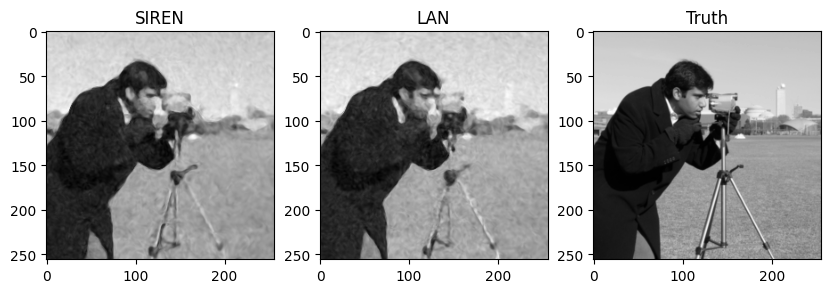

Step 200, SIREN loss 0.010348
Step 200, LAN loss 0.010235


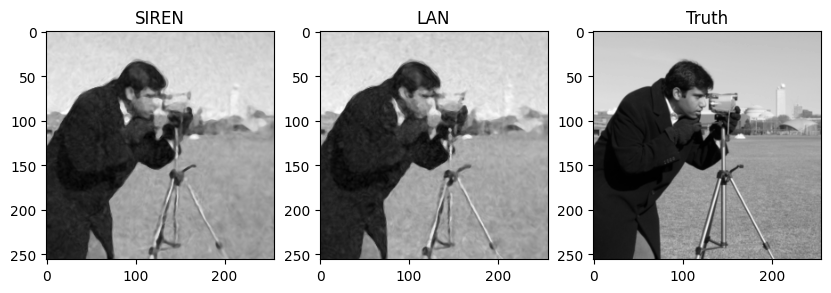

Step 300, SIREN loss 0.007908
Step 300, LAN loss 0.007288


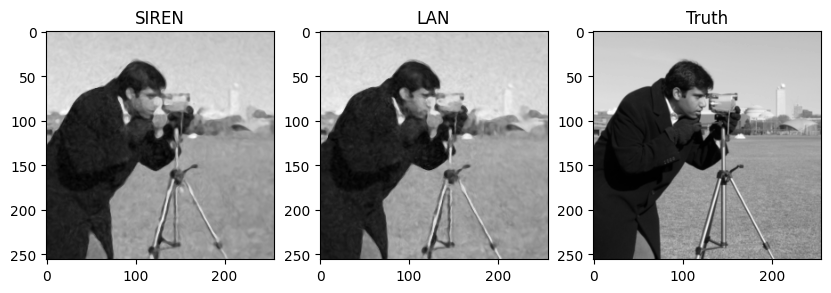

Step 400, SIREN loss 0.007262
Step 400, LAN loss 0.007148


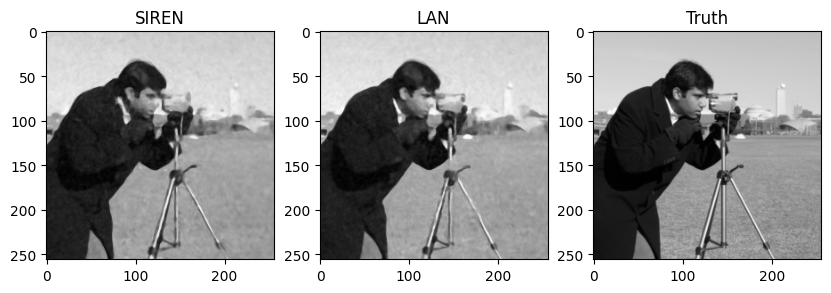

Step 500, SIREN loss 0.005936
Step 500, LAN loss 0.005750


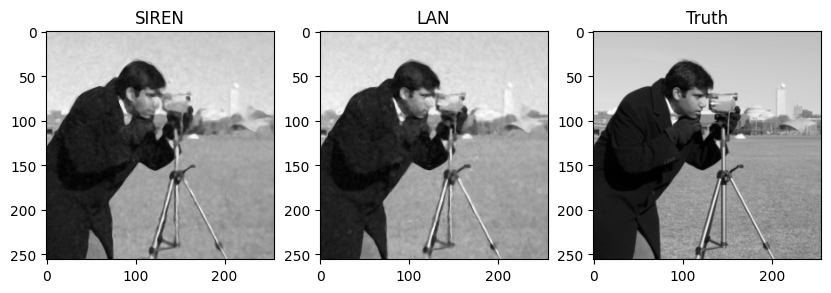

Step 600, SIREN loss 0.005757
Step 600, LAN loss 0.004709


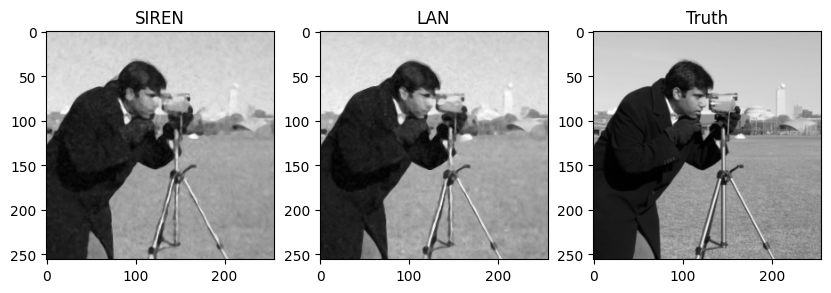

Step 700, SIREN loss 0.007841
Step 700, LAN loss 0.005490


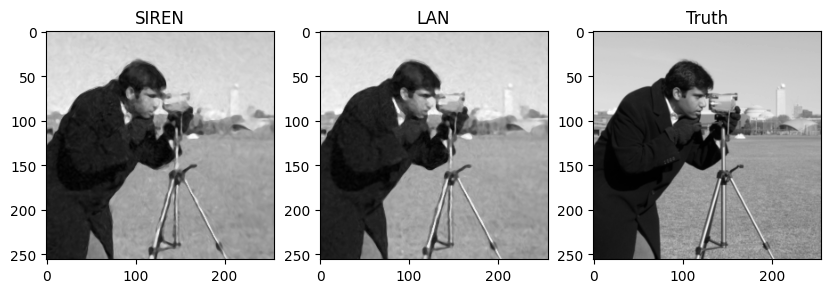

Step 800, SIREN loss 0.007680
Step 800, LAN loss 0.007046


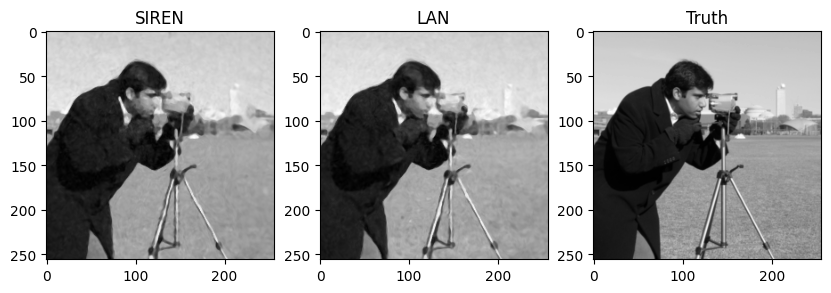

Step 900, SIREN loss 0.005472
Step 900, LAN loss 0.008330


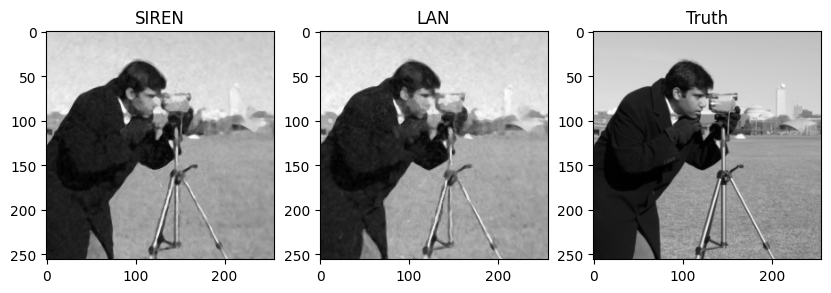

Step 1000, SIREN loss 0.005301
Step 1000, LAN loss 0.007232


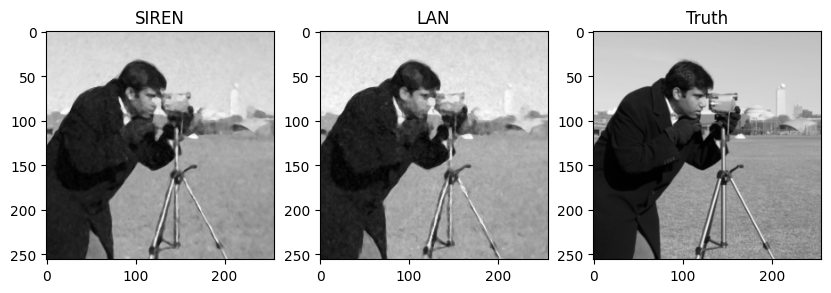

Step 1100, SIREN loss 0.000876
Step 1100, LAN loss 0.000957


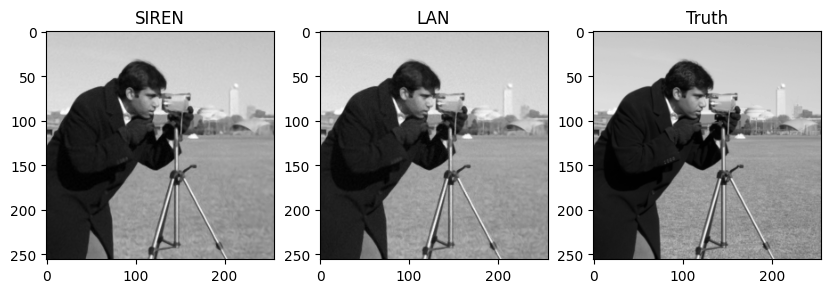

Step 1200, SIREN loss 0.000646
Step 1200, LAN loss 0.000630


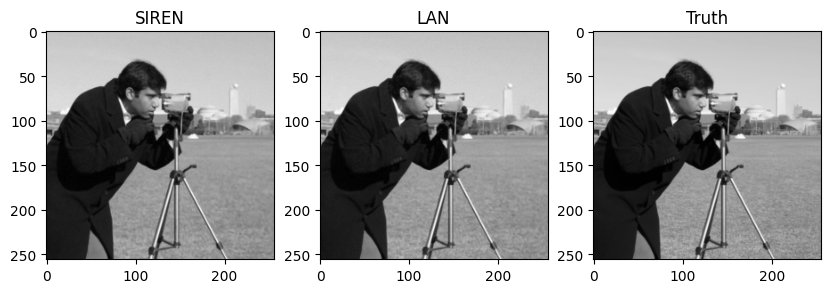

Step 1300, SIREN loss 0.000412
Step 1300, LAN loss 0.000385


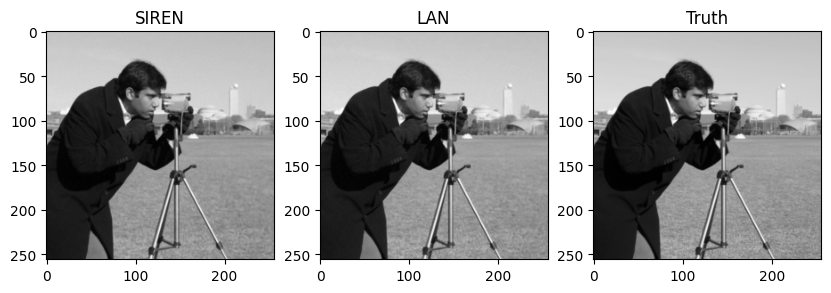

Step 1400, SIREN loss 0.000386
Step 1400, LAN loss 0.000327


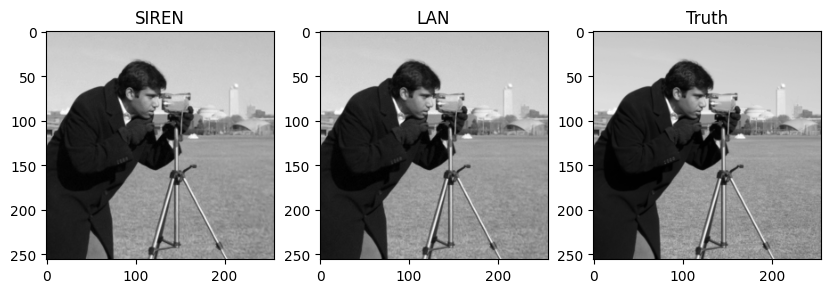

Step 1500, SIREN loss 0.000367
Step 1500, LAN loss 0.000351


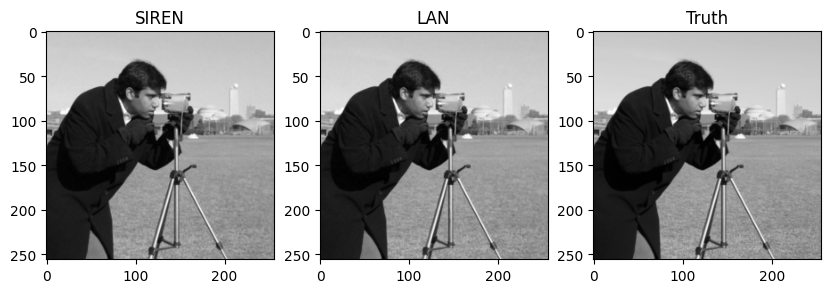

Step 1600, SIREN loss 0.000332
Step 1600, LAN loss 0.000292


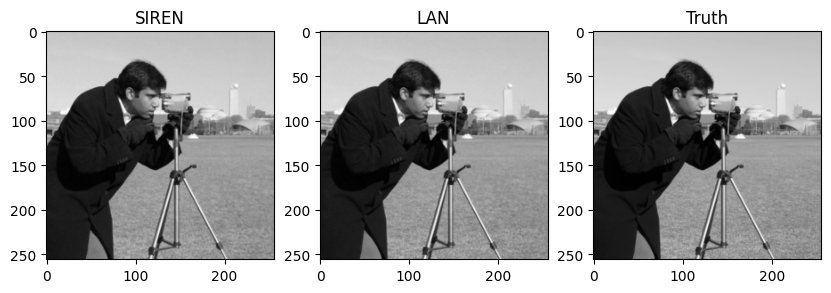

Step 1700, SIREN loss 0.000245
Step 1700, LAN loss 0.000210


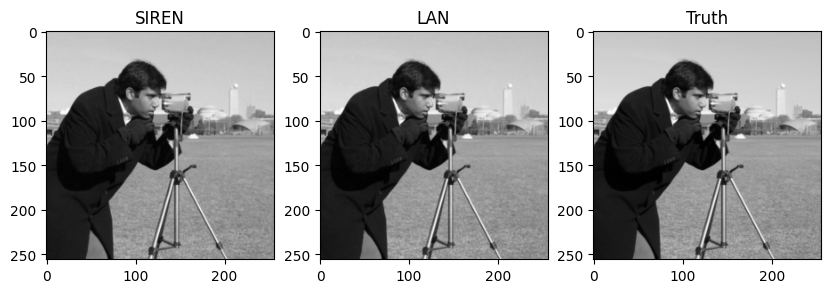

Step 1800, SIREN loss 0.000251
Step 1800, LAN loss 0.000220


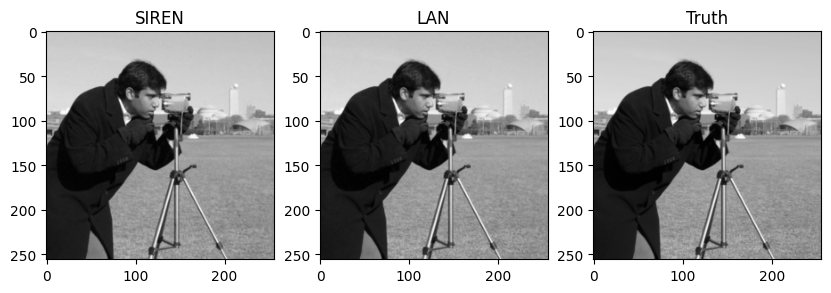

Step 1900, SIREN loss 0.000264
Step 1900, LAN loss 0.000269


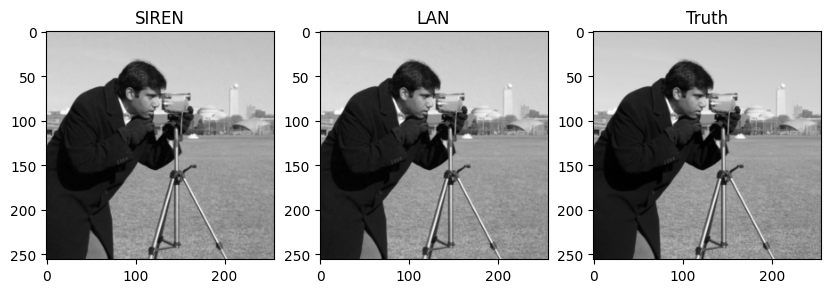

Step 2000, SIREN loss 0.000253
Step 2000, LAN loss 0.000344


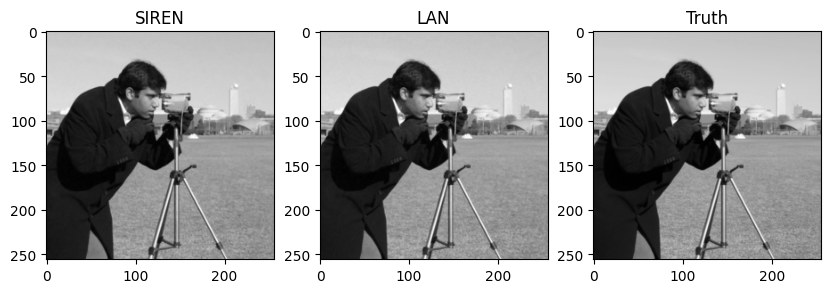

Step 2100, SIREN loss 0.000276
Step 2100, LAN loss 0.000375


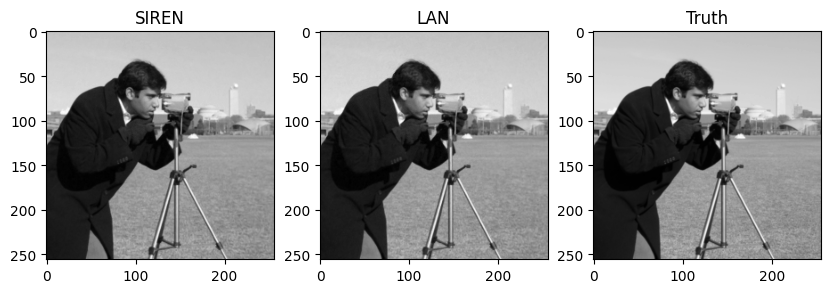

Step 2200, SIREN loss 0.000275
Step 2200, LAN loss 0.000357


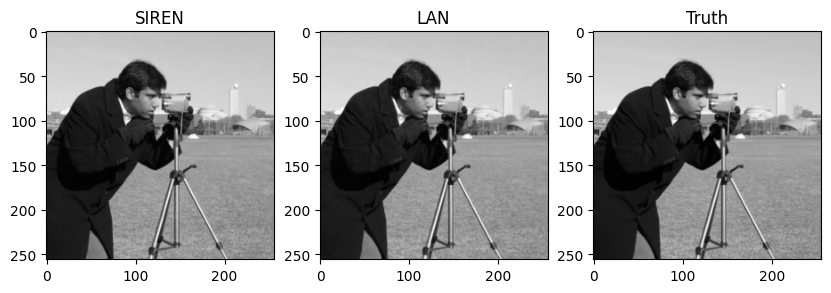

Step 2300, SIREN loss 0.000275
Step 2300, LAN loss 0.000190


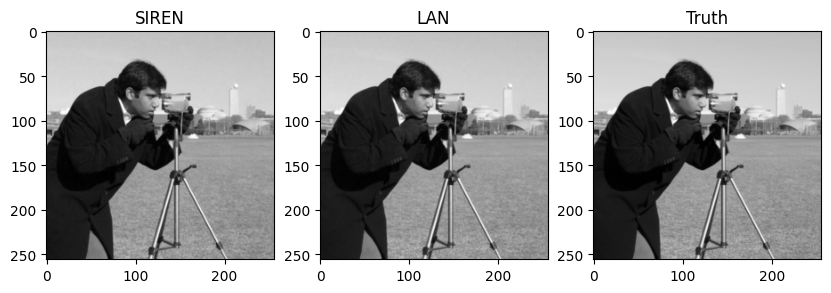

Step 2400, SIREN loss 0.000304
Step 2400, LAN loss 0.000159


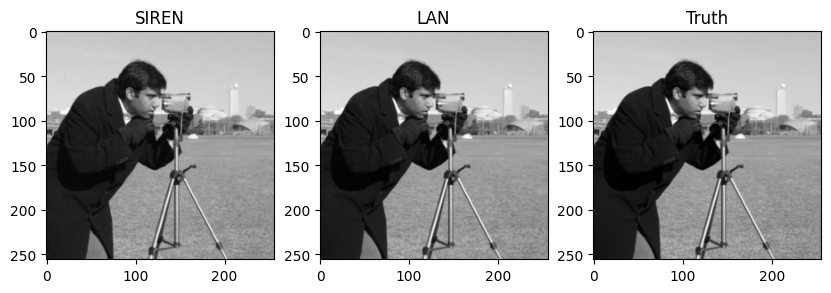

Step 2500, SIREN loss 0.000382
Step 2500, LAN loss 0.000178


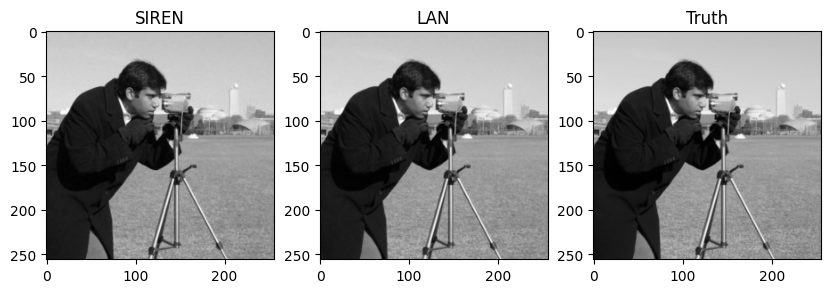

Step 2600, SIREN loss 0.000413
Step 2600, LAN loss 0.000167


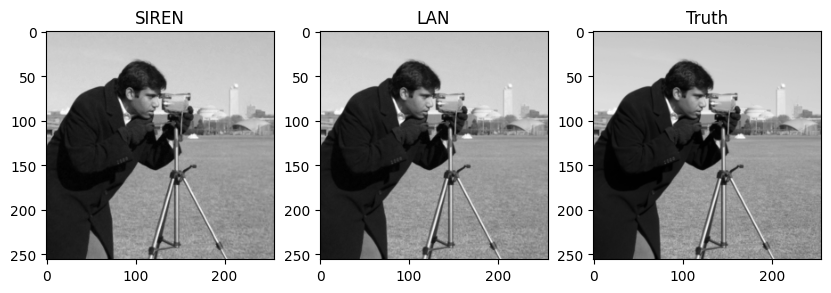

Step 2700, SIREN loss 0.000168
Step 2700, LAN loss 0.000179


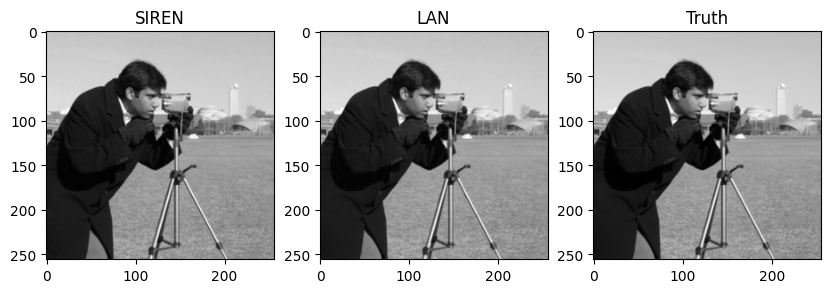

Step 2800, SIREN loss 0.000135
Step 2800, LAN loss 0.000216


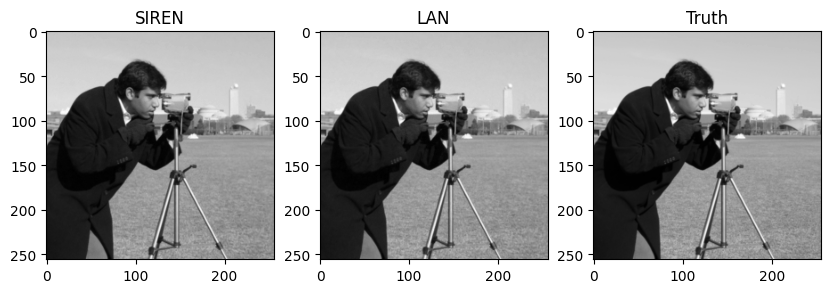

Step 2900, SIREN loss 0.000120
Step 2900, LAN loss 0.000420


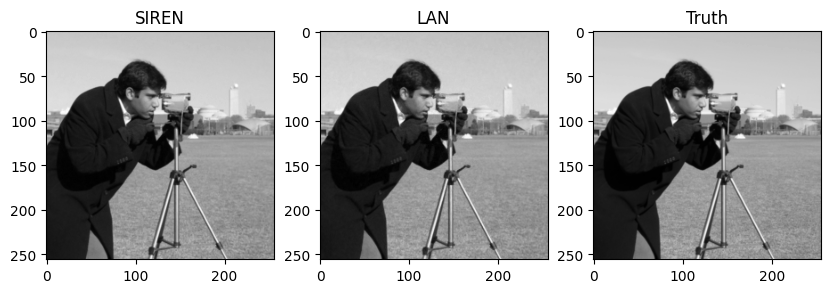

Step 3000, SIREN loss 0.000152
Step 3000, LAN loss 0.000352


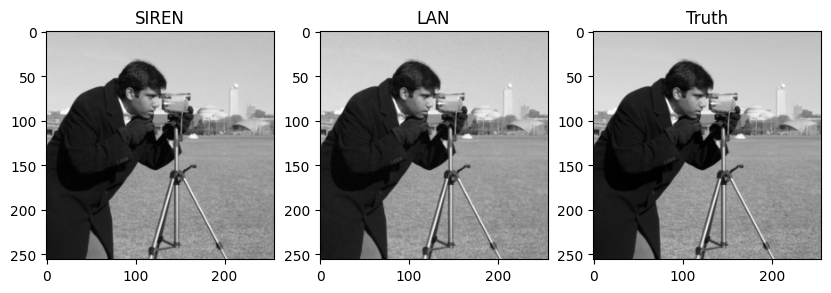

Step 3100, SIREN loss 0.000158
Step 3100, LAN loss 0.000488


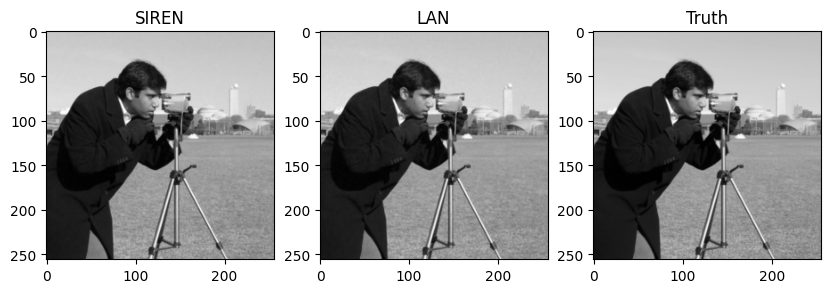

Step 3200, SIREN loss 0.000180
Step 3200, LAN loss 0.000228


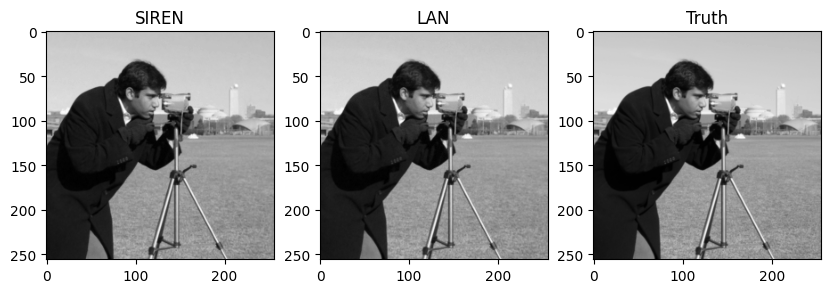

Step 3300, SIREN loss 0.000170
Step 3300, LAN loss 0.000107


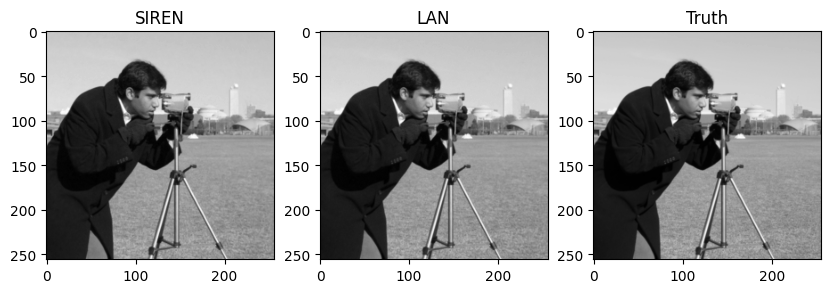

Step 3400, SIREN loss 0.000209
Step 3400, LAN loss 0.000096


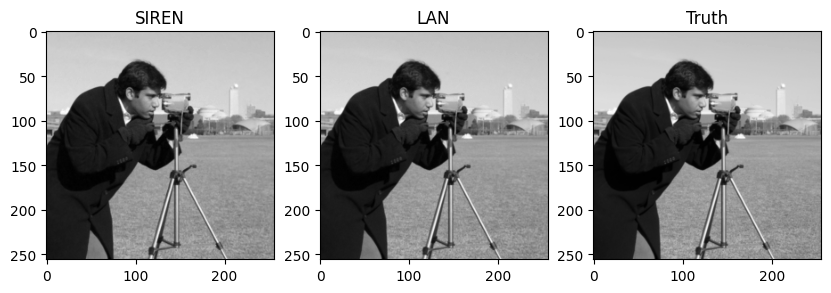

Step 3500, SIREN loss 0.000273
Step 3500, LAN loss 0.000121


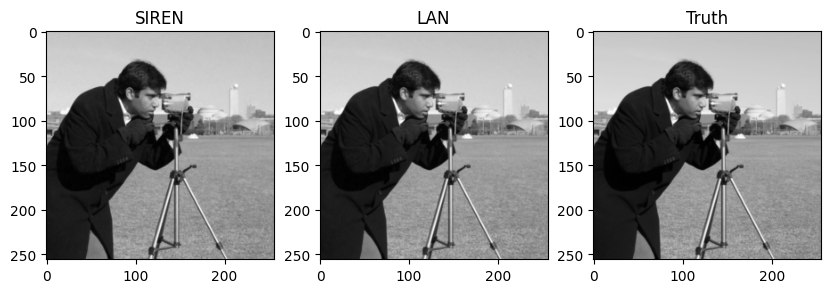

Step 3600, SIREN loss 0.000860
Step 3600, LAN loss 0.000124


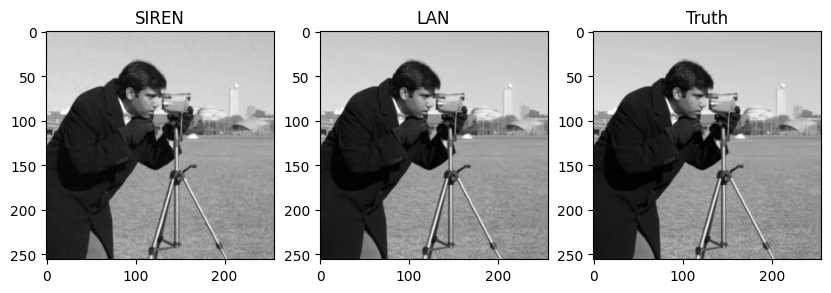

Step 3700, SIREN loss 0.000512
Step 3700, LAN loss 0.000148


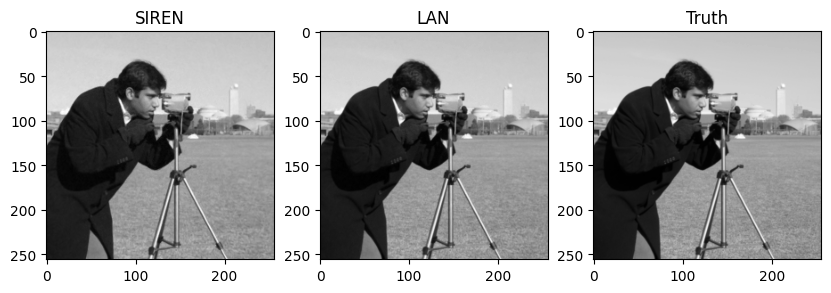

Step 3800, SIREN loss 0.000268
Step 3800, LAN loss 0.000191


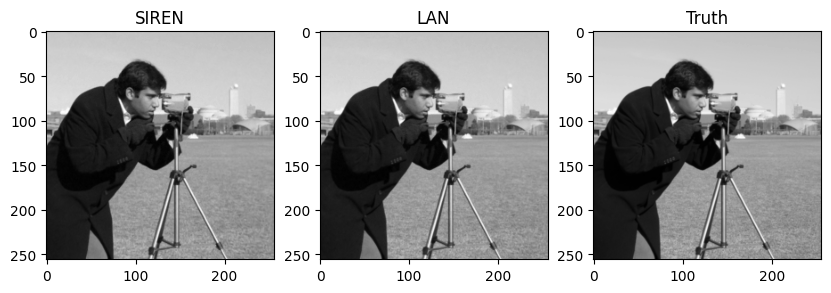

Step 3900, SIREN loss 0.000116
Step 3900, LAN loss 0.000219


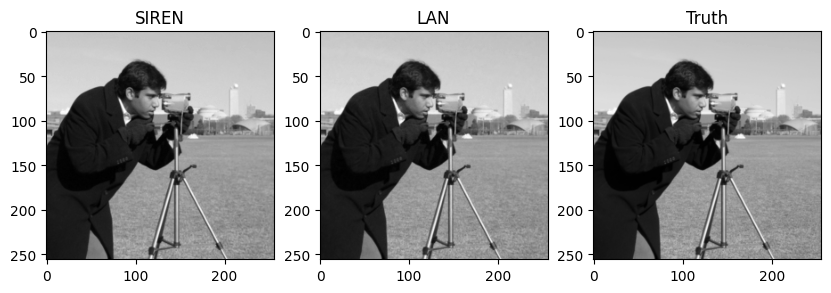

Step 4000, SIREN loss 0.000096
Step 4000, LAN loss 0.000593


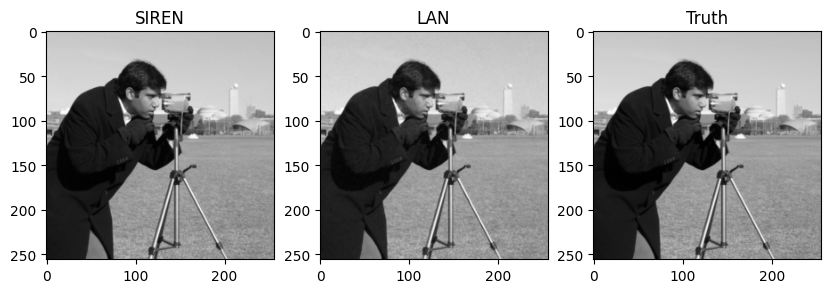

Step 4100, SIREN loss 0.000076
Step 4100, LAN loss 0.000900


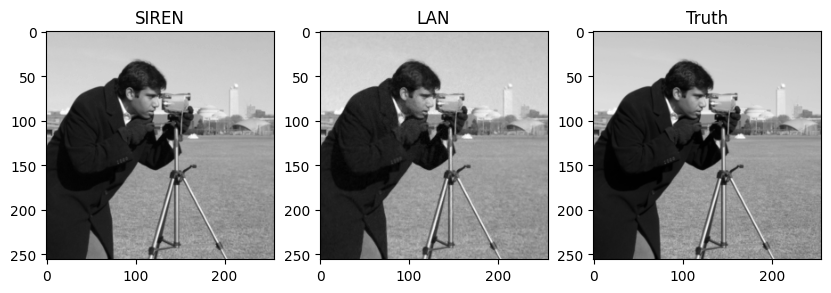

Step 4200, SIREN loss 0.000086
Step 4200, LAN loss 0.000388


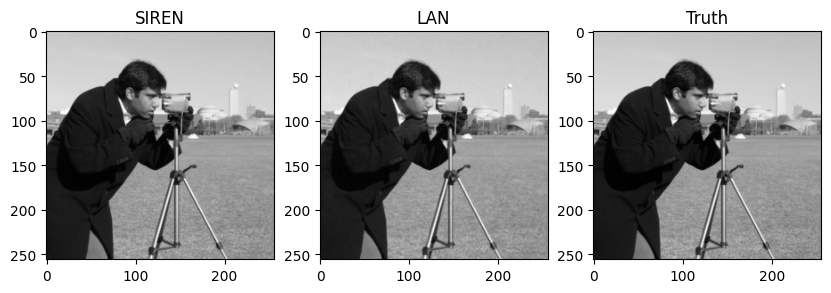

Step 4300, SIREN loss 0.000088
Step 4300, LAN loss 0.000141


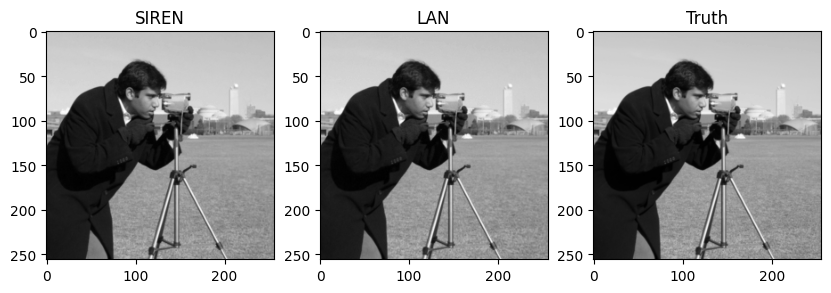

Step 4400, SIREN loss 0.000106
Step 4400, LAN loss 0.000116


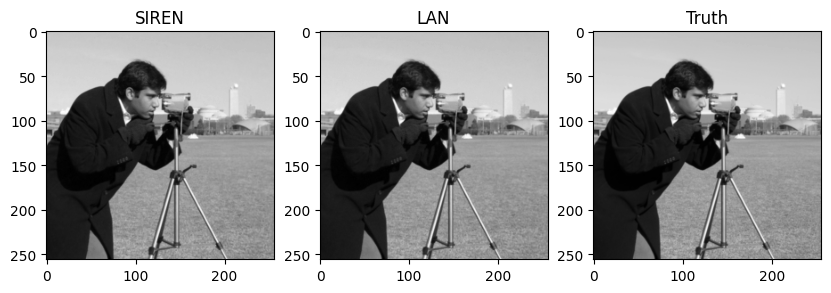

Step 4500, SIREN loss 0.000126
Step 4500, LAN loss 0.000095


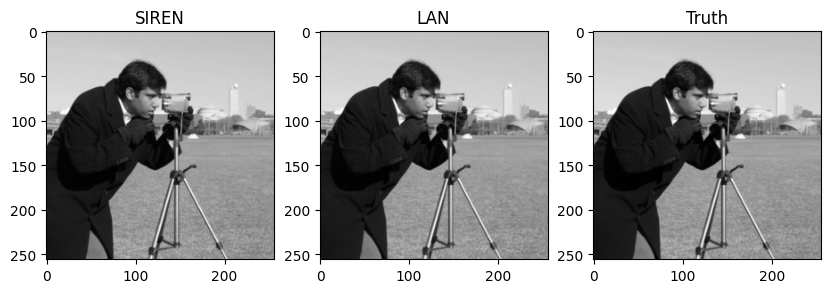

Step 4600, SIREN loss 0.000167
Step 4600, LAN loss 0.000094


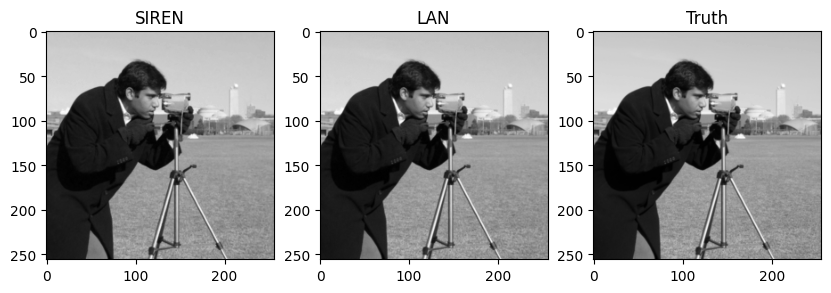

Step 4700, SIREN loss 0.000230
Step 4700, LAN loss 0.000095


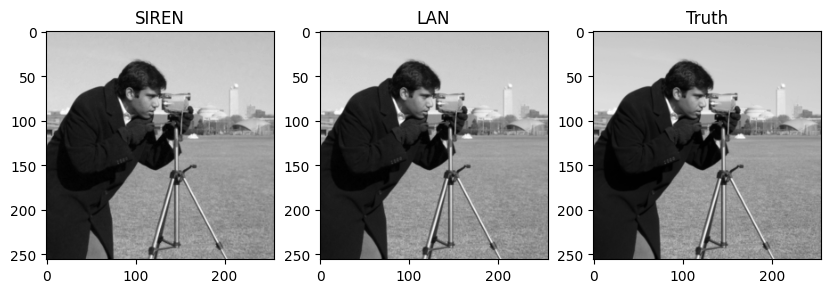

Step 4800, SIREN loss 0.000234
Step 4800, LAN loss 0.000116


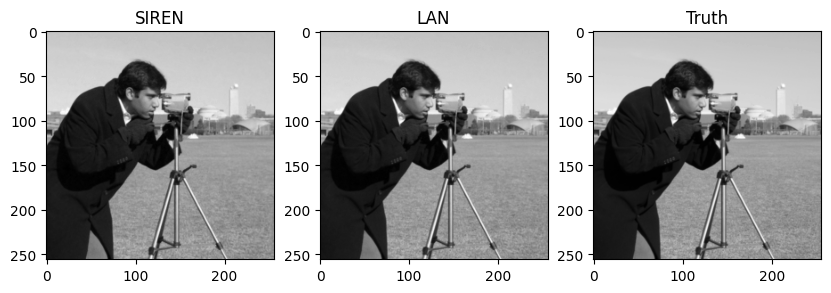

Step 4900, SIREN loss 0.000386
Step 4900, LAN loss 0.000135


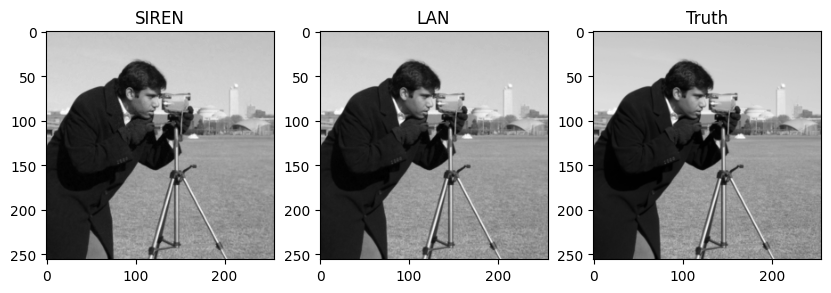

Step 5000, SIREN loss 0.001202
Step 5000, LAN loss 0.000264


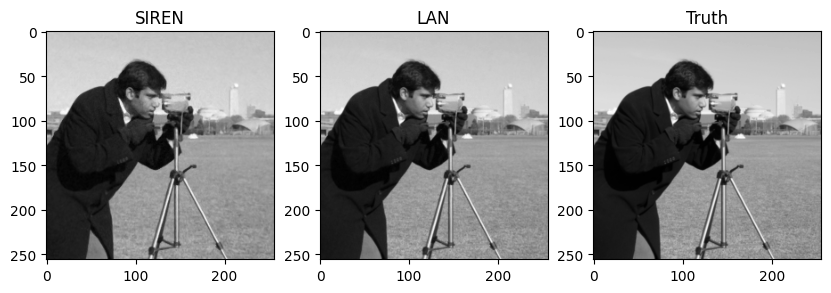

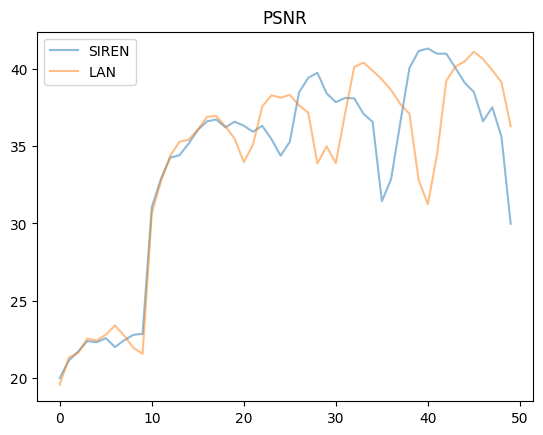

In [36]:
img = get_cameraman_tensor(sidelength)

full_data_input = get_mgrid(sidelength, 2)
full_data_target = img.permute(1, 2, 0).view(-1, 1)
models_dict = {'SIREN': img_siren, 'LAN': img_lan}
dataloader = dataloader
batch_size_infer = 4096
grad_accumulation = False
# grad_accumulation = True
total_steps = 5000
steps_til_summary = 100
lrs = [1e-3, 1e-4]
early = True
switch = 1000
plot_img = True
sidelength = 256
seed=SEED

global_outputs, psnr = train_compare_siren_lan(full_data_input,
                            full_data_target,
                            models_dict,
                            dataloader,
                            batch_size_infer,
                            grad_accumulation = grad_accumulation,
                            total_steps = total_steps, 
                            steps_til_summary = steps_til_summary, 
                            lrs = lrs, 
                            early = early,
                            switch = switch,
                            plot_img = plot_img,
                            sidelength = sidelength,
                            device=device, 
                            seed=seed)

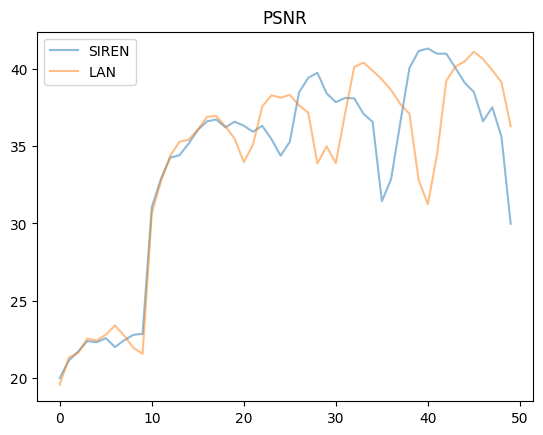

In [37]:
plot_loss(psnr, 'PSNR')

## Fitting an audio signal

In [38]:
import os
import scipy.io.wavfile as wavfile
import io
from IPython.display import Audio

if not os.path.exists('gt_bach.wav'):
    !wget https://vsitzmann.github.io/siren/img/audio/gt_bach.wav

--2024-05-26 10:59:25--  https://vsitzmann.github.io/siren/img/audio/gt_bach.wav
Resolving vsitzmann.github.io (vsitzmann.github.io)... 185.199.108.153, 185.199.109.153, 185.199.110.153, ...
Connecting to vsitzmann.github.io (vsitzmann.github.io)|185.199.108.153|:443... connected.
HTTP request sent, awaiting response... 301 Moved Permanently
Location: https://www.vincentsitzmann.com/siren/img/audio/gt_bach.wav [following]
--2024-05-26 10:59:25--  https://www.vincentsitzmann.com/siren/img/audio/gt_bach.wav
Resolving www.vincentsitzmann.com (www.vincentsitzmann.com)... 185.199.109.153, 185.199.108.153, 185.199.110.153, ...
Connecting to www.vincentsitzmann.com (www.vincentsitzmann.com)|185.199.109.153|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 1232886 (1.2M) [audio/wav]
Saving to: 'gt_bach.wav'

gt_bach.wav         100%[===================>]   1.17M  --.-KB/s    in 0.06s   

2024-05-26 10:59:25 (18.6 MB/s) - 'gt_bach.wav' saved [1232886/1232886]



In [41]:
class AudioFile(torch.utils.data.Dataset):
    def __init__(self, filename):
        self.rate, self.data = wavfile.read(filename)
        self.data = self.data.astype(np.float32)
        self.timepoints = get_mgrid(len(self.data), 1)
        self.scale = np.max(np.abs(self.data))
        self.amplitude = torch.Tensor(self.data/self.scale).view(-1, 1)
        

    def get_num_samples(self):
        return self.timepoints.shape[0]

    def __len__(self):
        return self.timepoints.size(0)

    def __getitem__(self, idx):
        return self.timepoints[idx], self.amplitude[idx]
    
# class AudioFile(torch.utils.data.Dataset):
#     def __init__(self, filename):
#         self.rate, self.data = wavfile.read(filename)
#         self.data = self.data.astype(np.float32)
#         self.timepoints = get_mgrid(len(self.data), 1)
        
#         amplitude = self.data
#         scale = np.max(np.abs(amplitude))
#         amplitude = (amplitude / scale)
#         amplitude = torch.Tensor(amplitude).view(-1, 1)
#         self.amplitude = amplitude

#     def get_num_samples(self):
#         return self.timepoints.shape[0]

#     def __len__(self):
#         return 1

#     def __getitem__(self, idx):
#         amplitude = self.data
#         scale = np.max(np.abs(amplitude))
#         amplitude = (amplitude / scale)
#         amplitude = torch.Tensor(amplitude).view(-1, 1)
#         return self.timepoints, amplitude

# Audio expriment

In [42]:
bach_audio = AudioFile('gt_bach.wav')

# bach_audio.__getitem__(0)[0].size(0)

bach_audio.__len__()

308207

In [43]:
SEED = 42
# batch_size = bach_audio.__len__()
batch_size = 4096
# batch_size =1
print(batch_size)
torch.manual_seed(SEED)
np.random.seed(SEED)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
hidden_features = 256
hidden_layers = 4
print(device)
in_features=1
out_features=1
first_w0=3000
# (self, in_features, out_features, hidden_features, first_w0=30, w0=30, device = 'cpu', num = 5, grid_range= [-1, 1]):


bach_audio = AudioFile('gt_bach.wav')
dataloader = DataLoader(bach_audio, shuffle=True, batch_size=batch_size, pin_memory=True, num_workers=4, drop_last=False)
# Note that we increase the frequency of the first layer to match the higher frequencies of the
# audio signal. Equivalently, we could also increase the range of the input coordinates.

audio_siren = Siren(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device = device, first_w0=first_w0)

audio_lan = LAN(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device = device, first_w0=first_w0)

4096
cuda


### Listen to the sample (useless if batch size is too smal or shuffle=True)

In [44]:
rate, _ = wavfile.read('gt_bach.wav')

model_input, ground_truth = next(iter(dataloader))
Audio(ground_truth.squeeze().numpy(),rate=rate)

Step 500, SIREN loss 0.026344
Step 500, LAN loss 0.025873


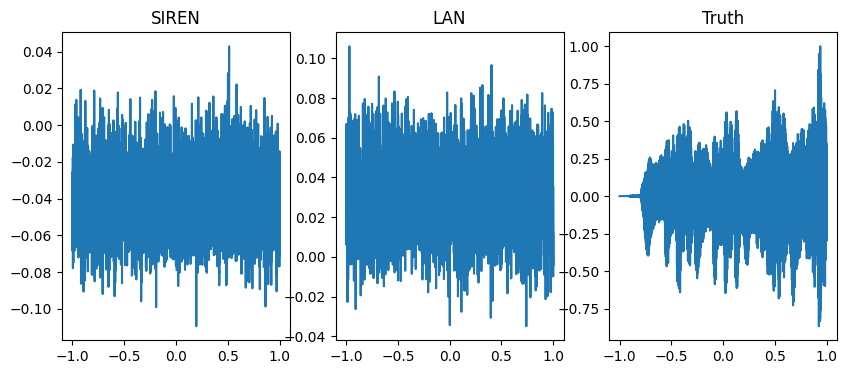

Step 1000, SIREN loss 0.021713
Step 1000, LAN loss 0.021288


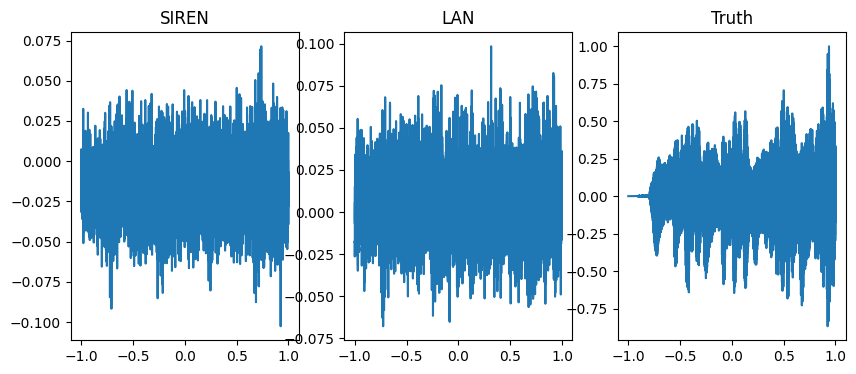

Step 1500, SIREN loss 0.019357
Step 1500, LAN loss 0.019186


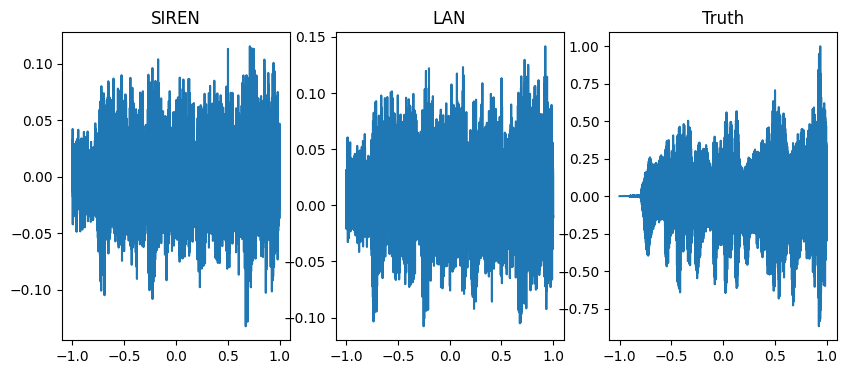

Step 2000, SIREN loss 0.016593
Step 2000, LAN loss 0.015902


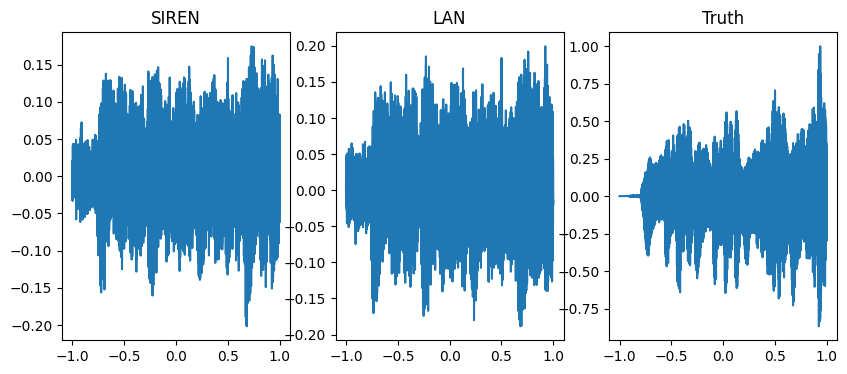

Step 2500, SIREN loss 0.013174
Step 2500, LAN loss 0.012192


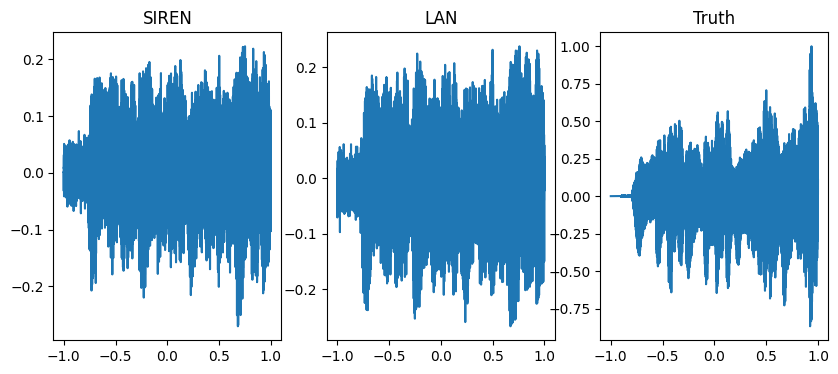

Step 3000, SIREN loss 0.009662
Step 3000, LAN loss 0.008736


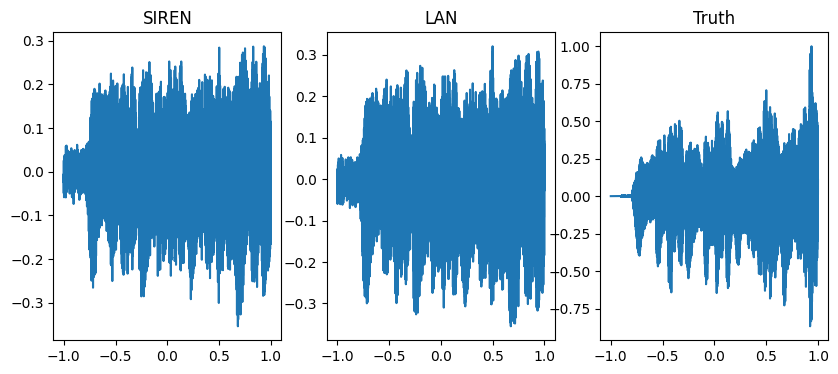

Step 3500, SIREN loss 0.007361
Step 3500, LAN loss 0.006974


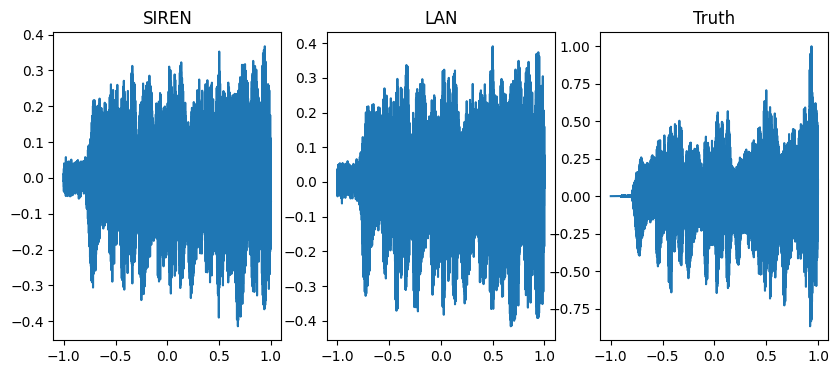

Step 4000, SIREN loss 0.005340
Step 4000, LAN loss 0.005312


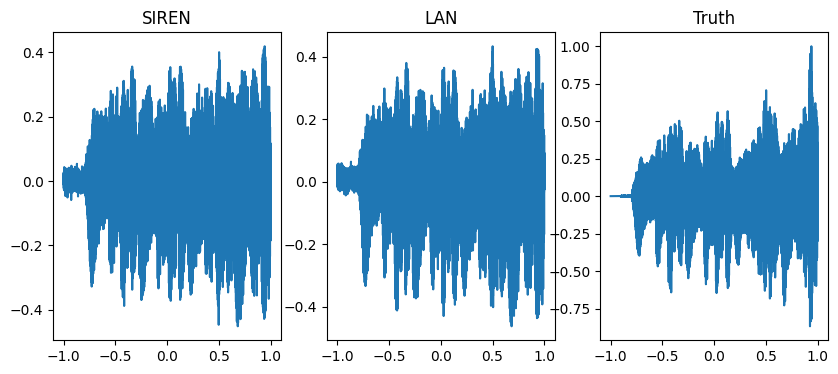

Step 4500, SIREN loss 0.004477
Step 4500, LAN loss 0.004636


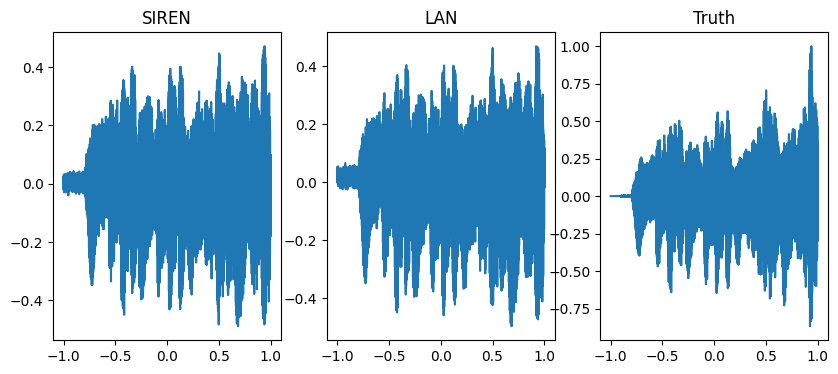

Step 5000, SIREN loss 0.004083
Step 5000, LAN loss 0.003916


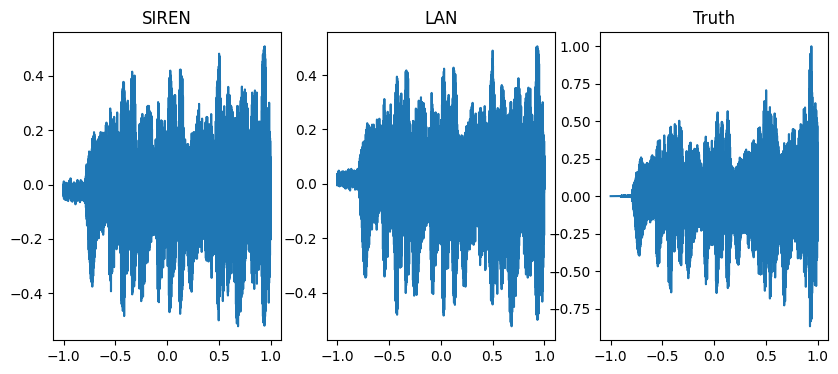

Step 5500, SIREN loss 0.003395
Step 5500, LAN loss 0.003388


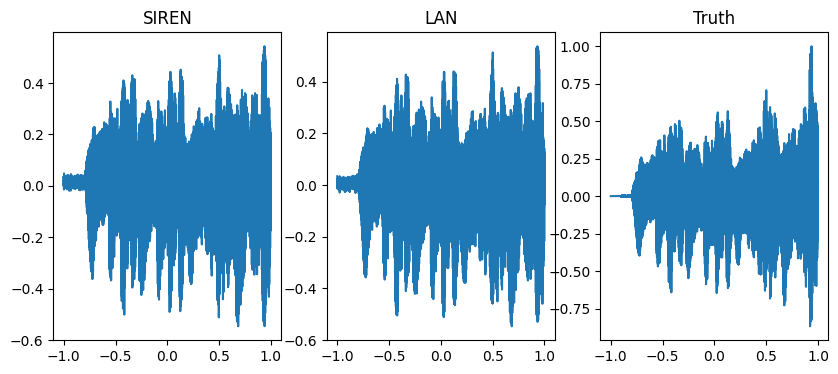

Step 6000, SIREN loss 0.003033
Step 6000, LAN loss 0.003742


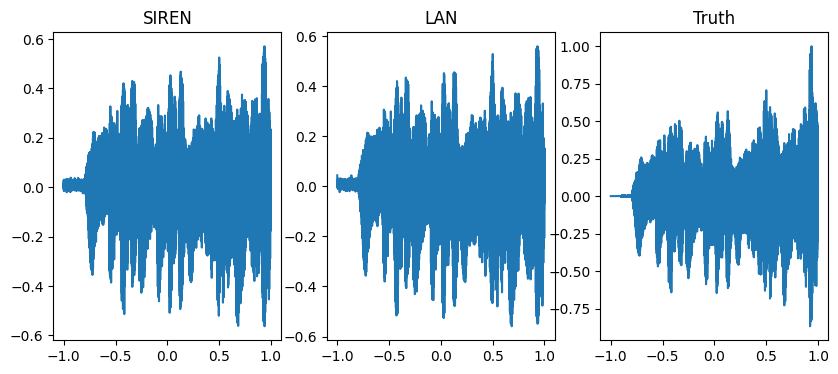

Step 6500, SIREN loss 0.002817
Step 6500, LAN loss 0.003062


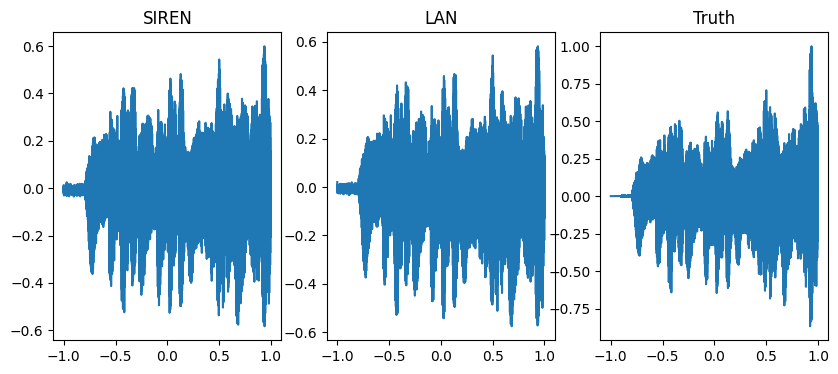

Step 7000, SIREN loss 0.002381
Step 7000, LAN loss 0.002674


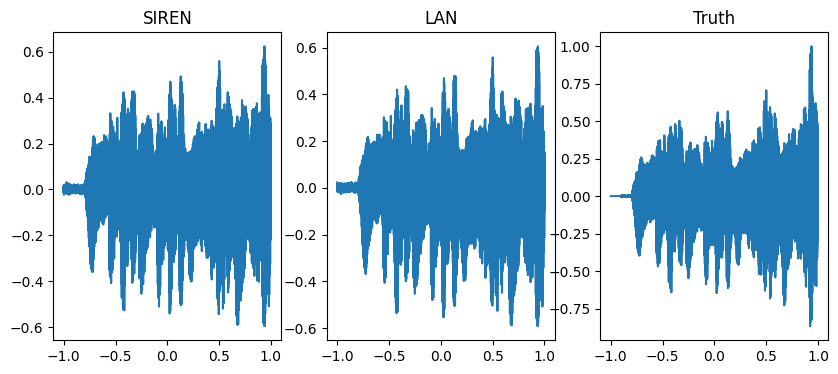

Step 7500, SIREN loss 0.002147
Step 7500, LAN loss 0.002401


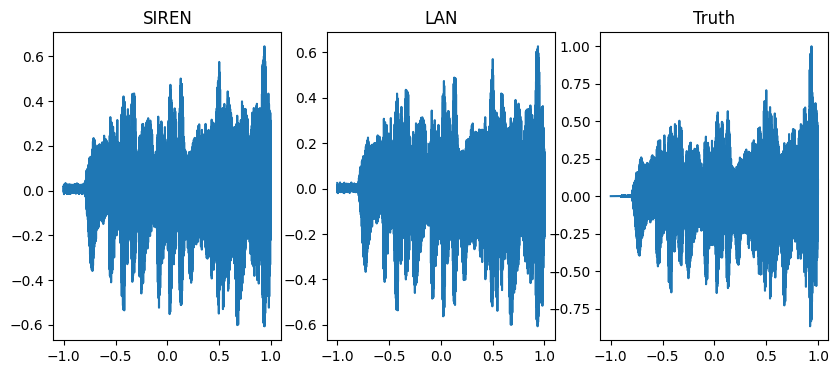

Step 8000, SIREN loss 0.002148
Step 8000, LAN loss 0.002393


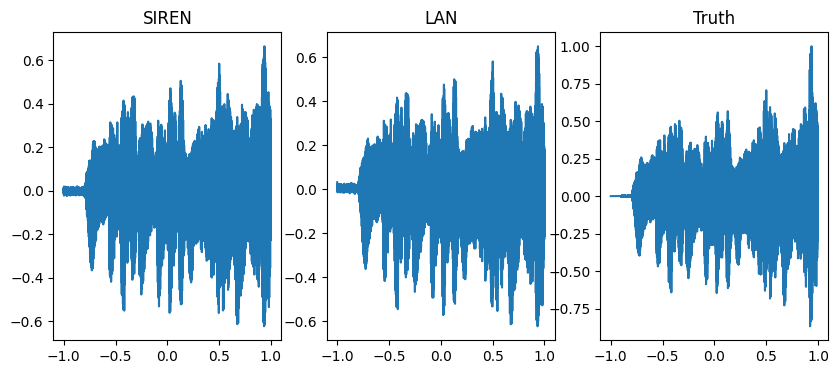

Step 8500, SIREN loss 0.001871
Step 8500, LAN loss 0.002331


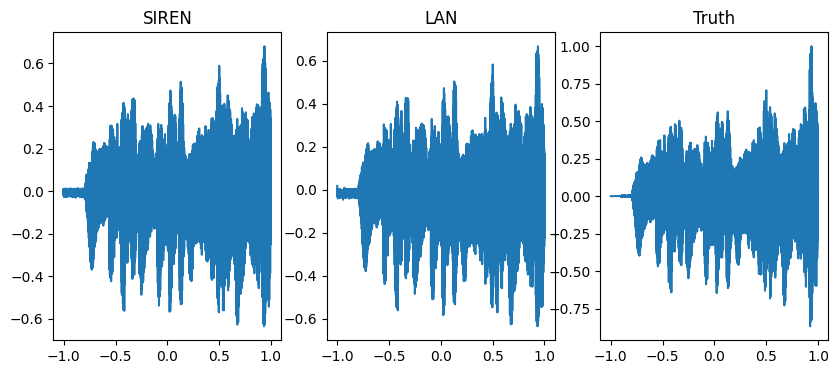

Step 9000, SIREN loss 0.001632
Step 9000, LAN loss 0.001866


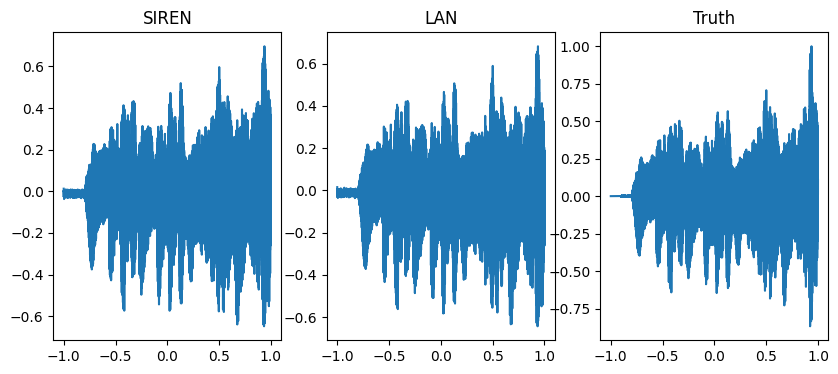

Step 9500, SIREN loss 0.001418
Step 9500, LAN loss 0.001892


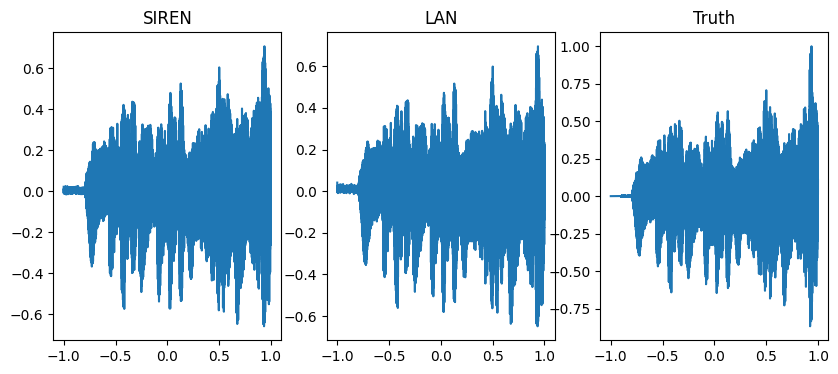

Step 10000, SIREN loss 0.001643
Step 10000, LAN loss 0.001730


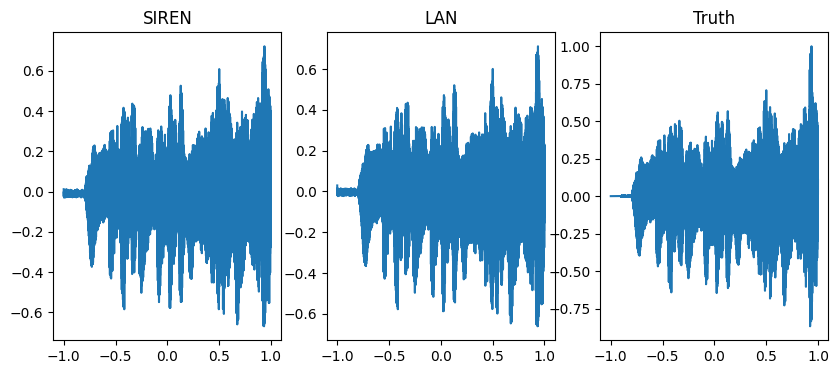

Step 10500, SIREN loss 0.001407
Step 10500, LAN loss 0.001499


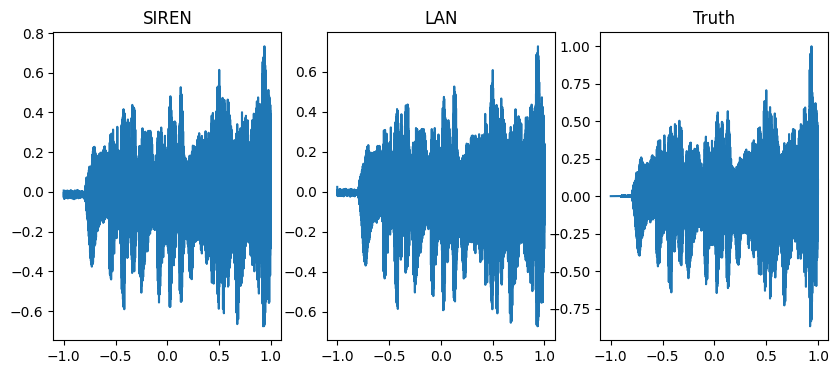

Step 11000, SIREN loss 0.001328
Step 11000, LAN loss 0.001468


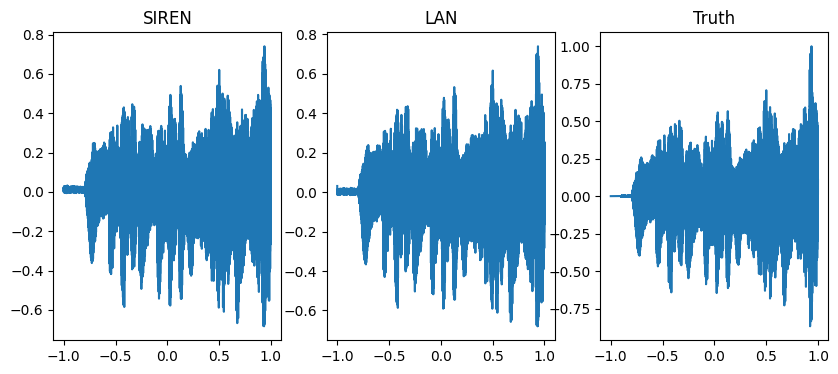

Step 11500, SIREN loss 0.001133
Step 11500, LAN loss 0.001360


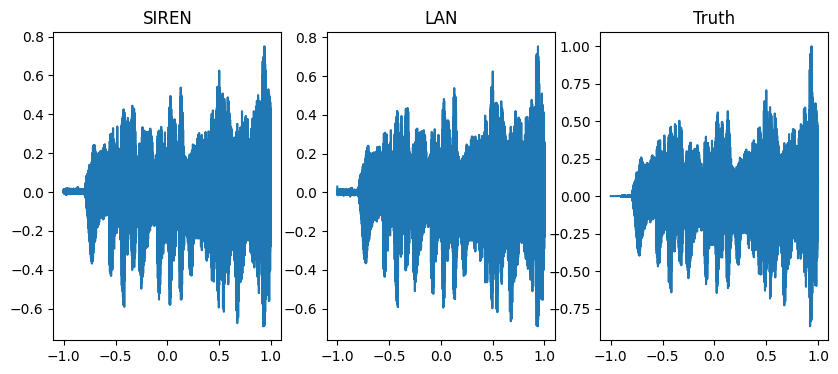

Step 12000, SIREN loss 0.001192
Step 12000, LAN loss 0.001459


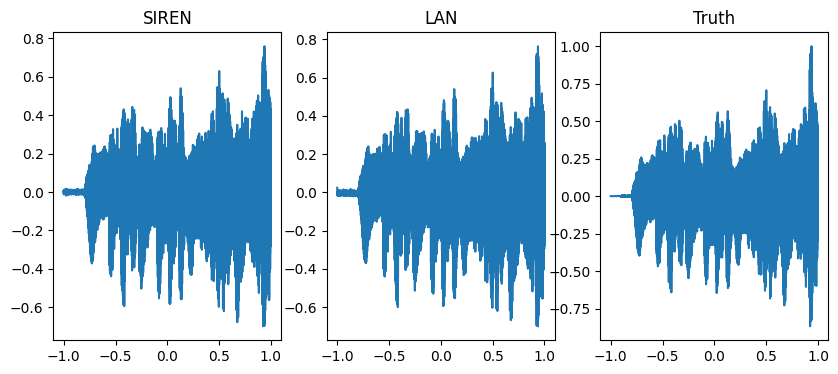

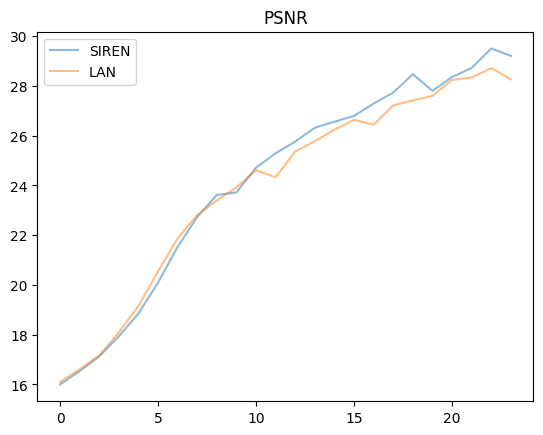

In [45]:
# models_dict = {'SIREN': audio_siren}
# models_dict = {'LAN': audio_lan}
models_dict = {'SIREN': audio_siren, 'LAN': audio_lan}

full_data_input = bach_audio.timepoints
full_data_target = bach_audio.amplitude


dataloader = dataloader
batch_size_infer = 4096*4
grad_accumulation = True
total_steps = 12000
steps_til_summary = 500
lrs = [1e-4, 1e-4]
early = False
switch = 1000
plot_img = False
sidelength = 256
seed=SEED
# no_batch = True
no_batch = False
global_outputs, psnr = train_compare_siren_lan(full_data_input,
                            full_data_target,
                            models_dict,
                            dataloader,
                            batch_size_infer,
                            no_batch =  no_batch,                   
                            grad_accumulation = grad_accumulation,
                            total_steps = total_steps, 
                            steps_til_summary = steps_til_summary, 
                            lrs = lrs, 
                            early = early,
                            switch = switch,
                            plot_img = plot_img,
                            sidelength = sidelength,
                            device=device, 
                            seed=seed)

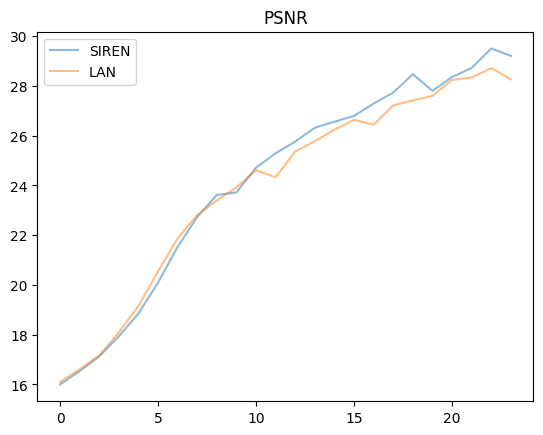

In [46]:
plot_loss(psnr, 'PSNR')

## Listen to the final outputs

In [47]:
Audio(global_outputs['SIREN'].squeeze().detach().cpu().numpy(),rate=rate)

In [48]:
Audio(global_outputs['LAN'].squeeze().detach().cpu().numpy(),rate=rate)

# Image experiment with grad accumulation

In [51]:
sidelength = 256
batch_size = 4096
# batch_size =65536
cameraman = ImageFitting(sidelength)
dataloader = DataLoader(cameraman, batch_size=batch_size, pin_memory=True, num_workers=4, drop_last=False, shuffle = True)
global_image_coors = get_mgrid(sidelength, 2)



SEED = 42

torch.manual_seed(SEED)
np.random.seed(SEED)

device = 'cuda' if torch.cuda.is_available() else 'cpu'
hidden_features = 128
print(device)
in_features=2
out_features=1
hidden_layers = 4

img_siren = Siren(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device =device)
img_lan = LAN(in_features=in_features, out_features=out_features, hidden_features=hidden_features, hidden_layers = hidden_layers, device = device)

cuda


Step 100, SIREN loss 0.157713
Step 100, LAN loss 0.141059


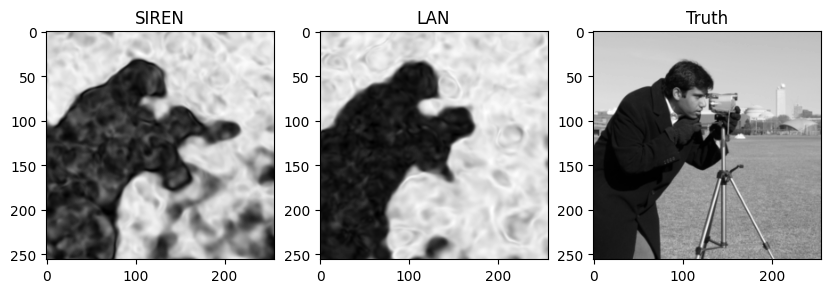

Step 200, SIREN loss 0.035351
Step 200, LAN loss 0.029747


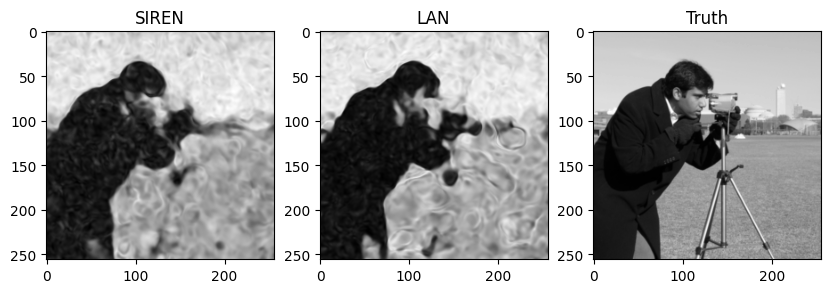

Step 300, SIREN loss 0.014767
Step 300, LAN loss 0.018110


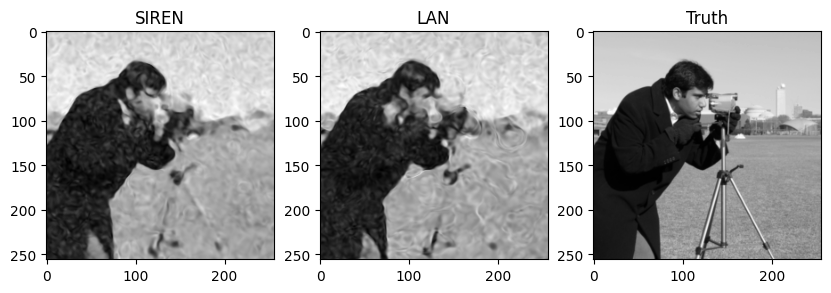

Step 400, SIREN loss 0.010050
Step 400, LAN loss 0.012196


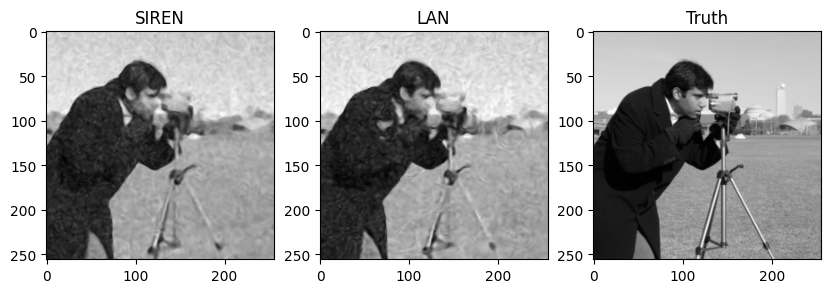

Step 500, SIREN loss 0.006456
Step 500, LAN loss 0.007209


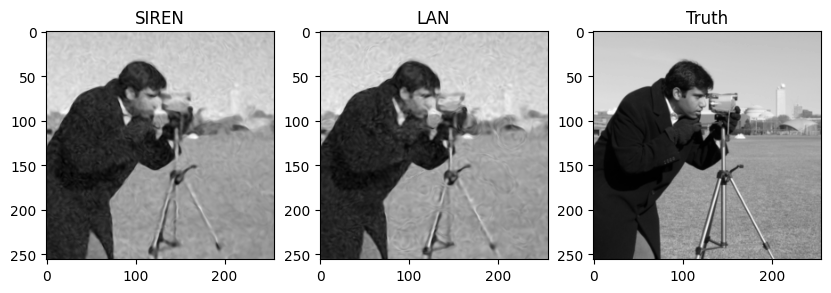

Step 600, SIREN loss 0.004418
Step 600, LAN loss 0.005089


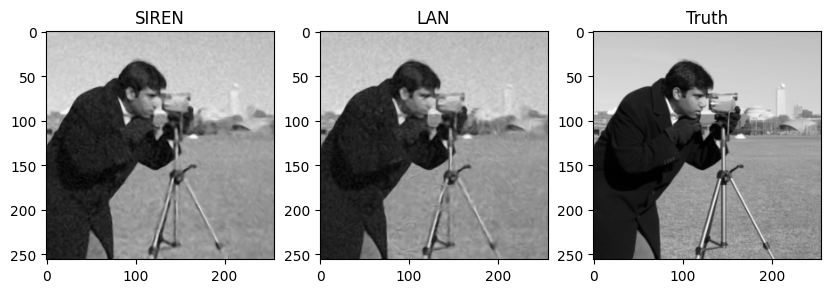

Step 700, SIREN loss 0.004155
Step 700, LAN loss 0.004220


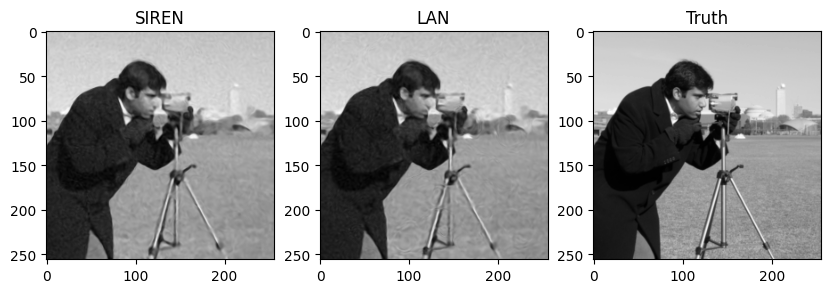

Step 800, SIREN loss 0.002682
Step 800, LAN loss 0.003223


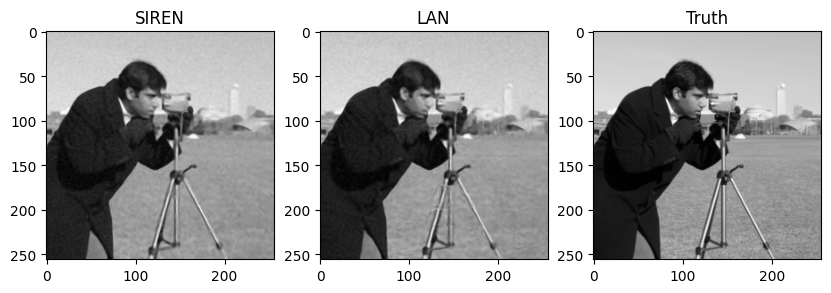

Step 900, SIREN loss 0.002317
Step 900, LAN loss 0.002300


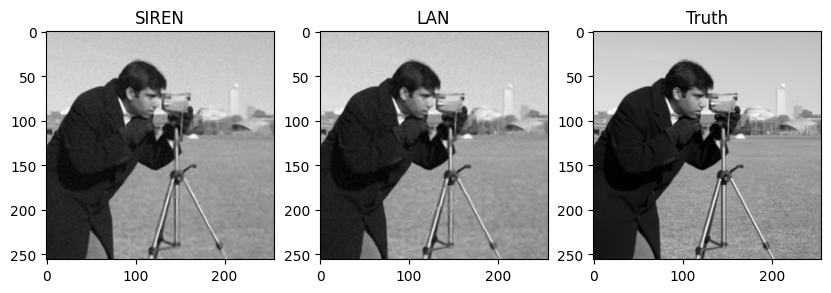

Step 1000, SIREN loss 0.001825
Step 1000, LAN loss 0.001780


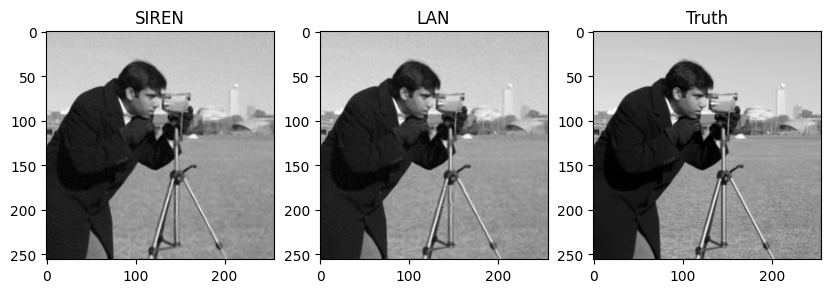

Step 1100, SIREN loss 0.003185
Step 1100, LAN loss 0.003079


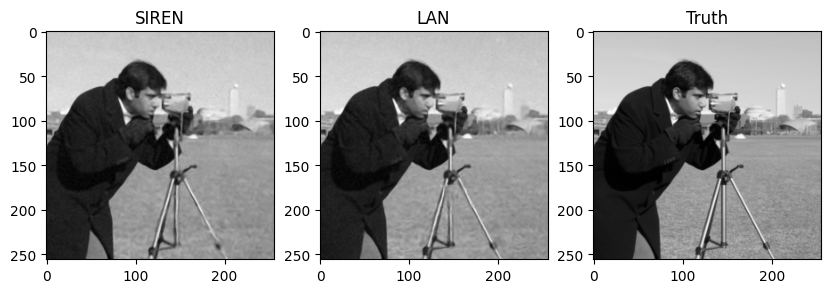

Step 1200, SIREN loss 0.002182
Step 1200, LAN loss 0.002053


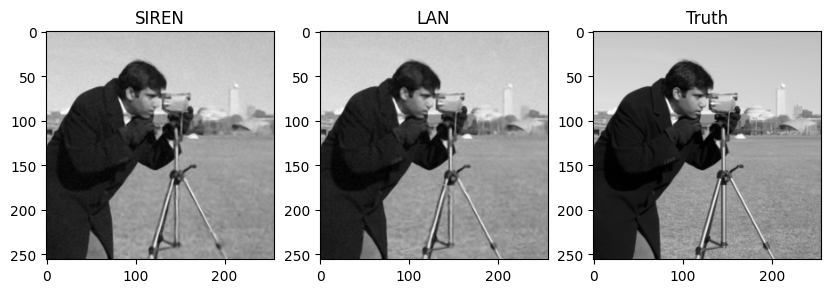

Step 1300, SIREN loss 0.001992
Step 1300, LAN loss 0.001729


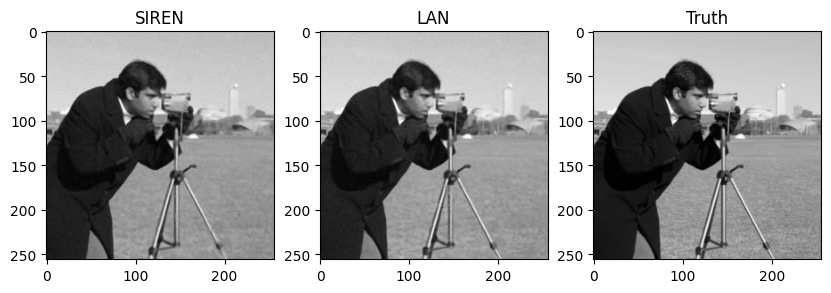

Step 1400, SIREN loss 0.001526
Step 1400, LAN loss 0.001412


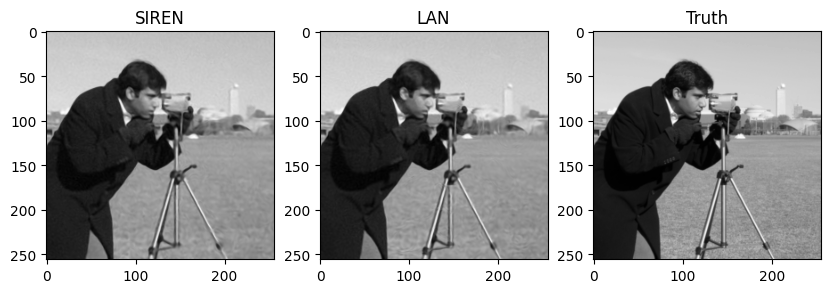

Step 1500, SIREN loss 0.001354
Step 1500, LAN loss 0.001222


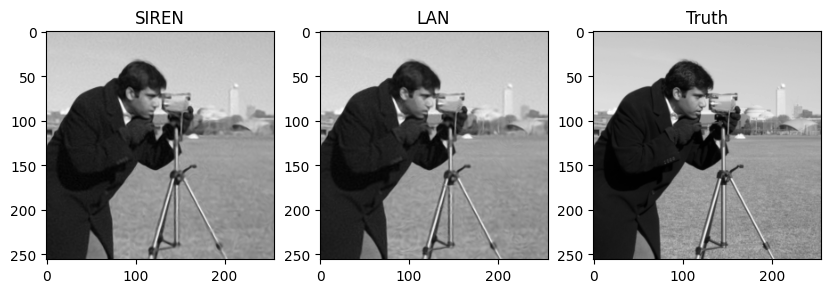

Step 1600, SIREN loss 0.001239
Step 1600, LAN loss 0.001066


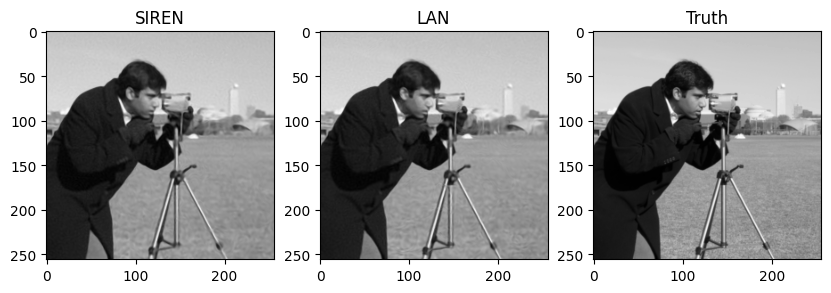

Step 1700, SIREN loss 0.001104
Step 1700, LAN loss 0.001011


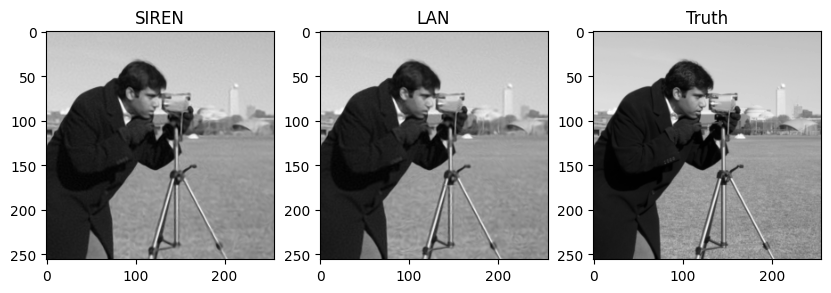

Step 1800, SIREN loss 0.001016
Step 1800, LAN loss 0.000953


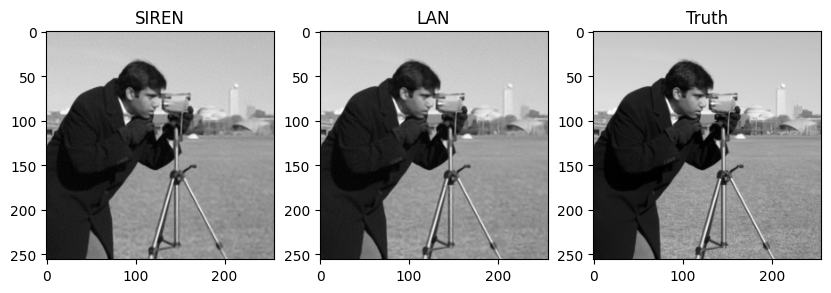

Step 1900, SIREN loss 0.000919
Step 1900, LAN loss 0.000866


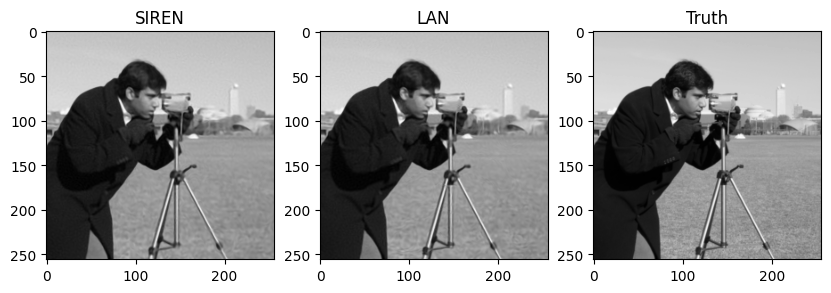

Step 2000, SIREN loss 0.000940
Step 2000, LAN loss 0.000807


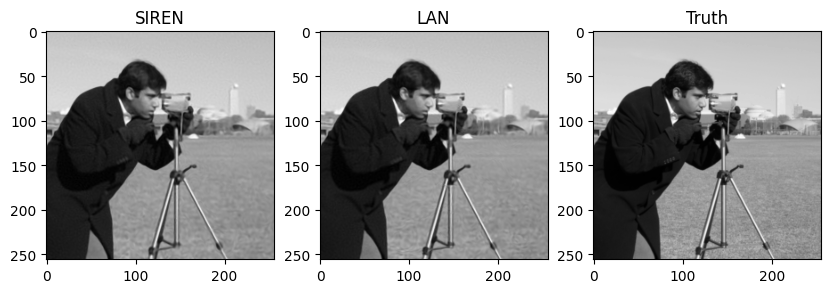

Step 2100, SIREN loss 0.000881
Step 2100, LAN loss 0.000758


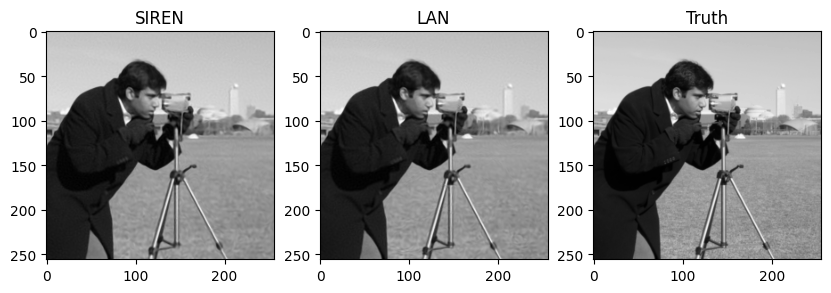

Step 2200, SIREN loss 0.000879
Step 2200, LAN loss 0.000794


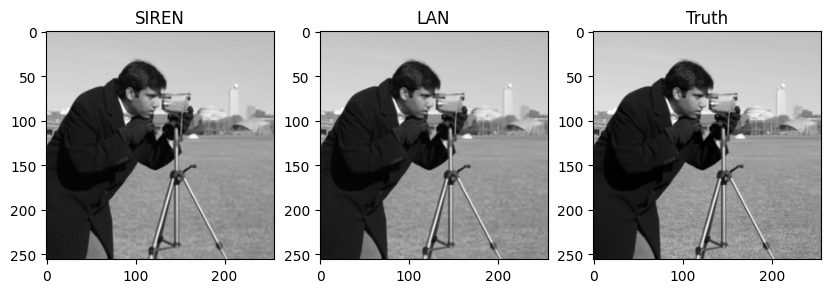

Step 2300, SIREN loss 0.000772
Step 2300, LAN loss 0.000679


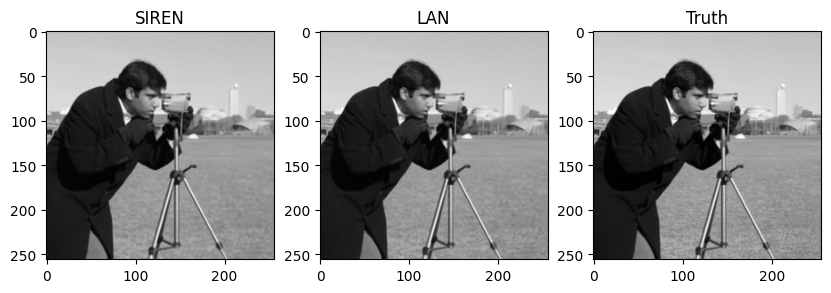

Step 2400, SIREN loss 0.000736
Step 2400, LAN loss 0.000654


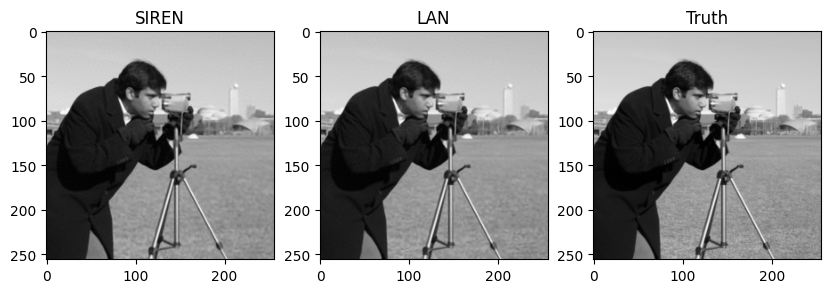

Step 2500, SIREN loss 0.000770
Step 2500, LAN loss 0.000630


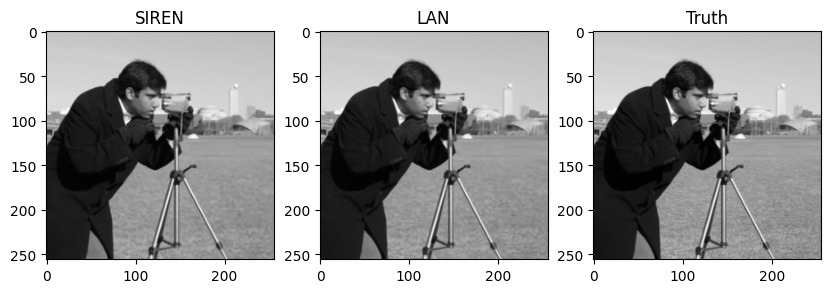

Step 2600, SIREN loss 0.000749
Step 2600, LAN loss 0.000639


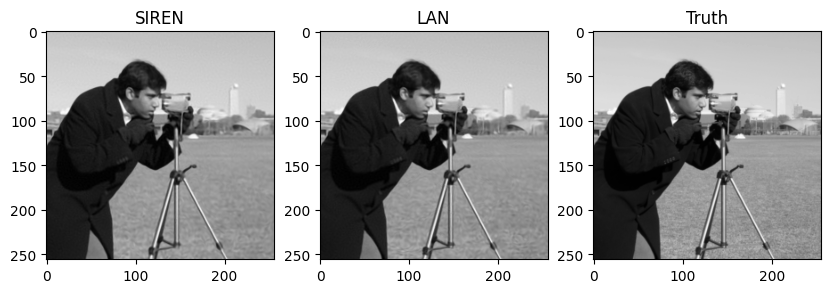

Step 2700, SIREN loss 0.000661
Step 2700, LAN loss 0.000588


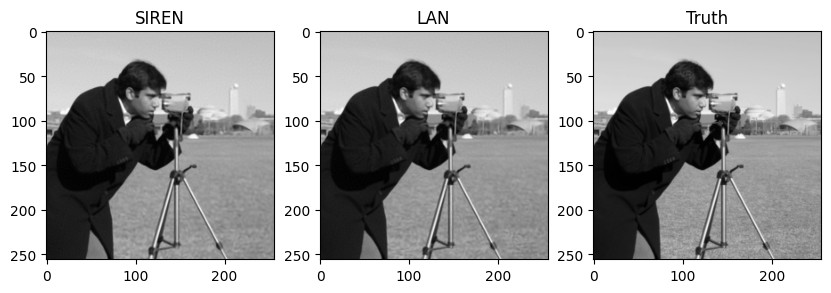

Step 2800, SIREN loss 0.000655
Step 2800, LAN loss 0.000567


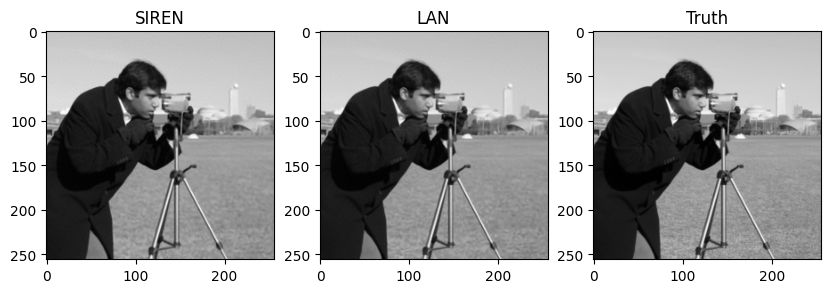

Step 2900, SIREN loss 0.000615
Step 2900, LAN loss 0.000546


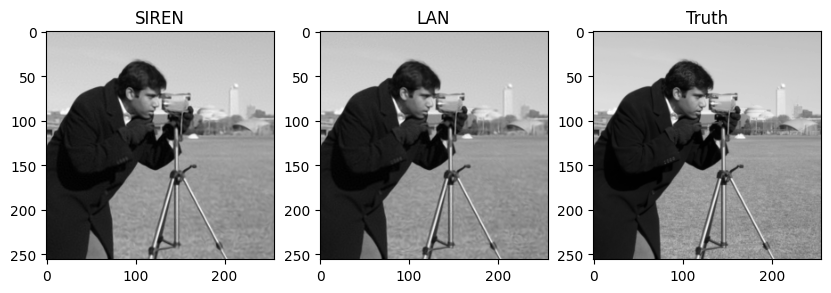

Step 3000, SIREN loss 0.000598
Step 3000, LAN loss 0.000530


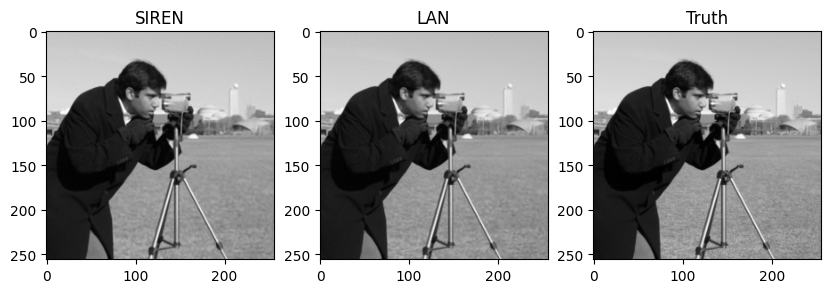

Step 3100, SIREN loss 0.000665
Step 3100, LAN loss 0.000566


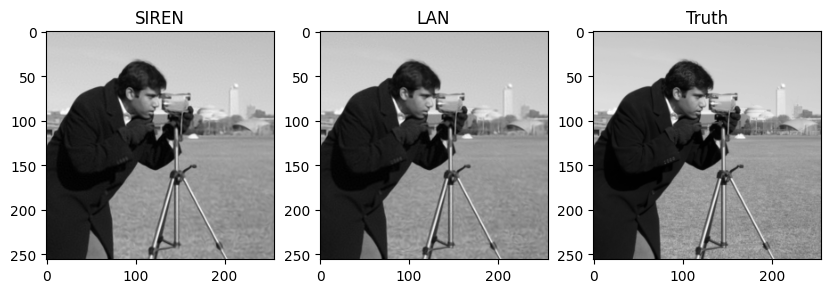

Step 3200, SIREN loss 0.000572
Step 3200, LAN loss 0.000493


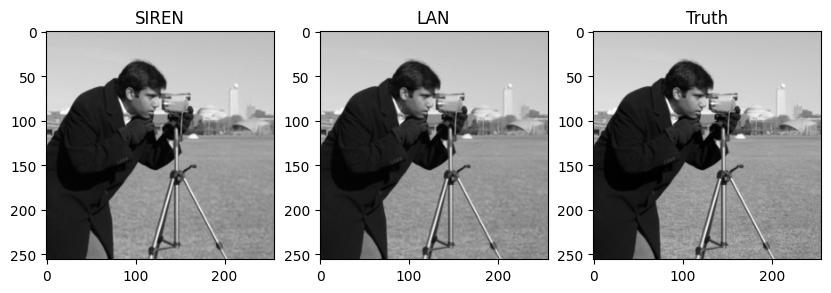

Step 3300, SIREN loss 0.000572
Step 3300, LAN loss 0.000490


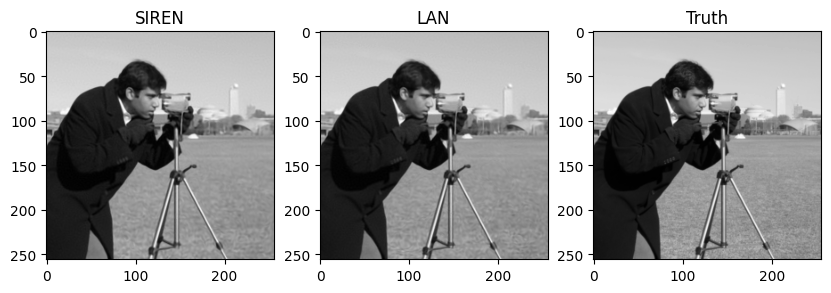

Step 3400, SIREN loss 0.000545
Step 3400, LAN loss 0.000490


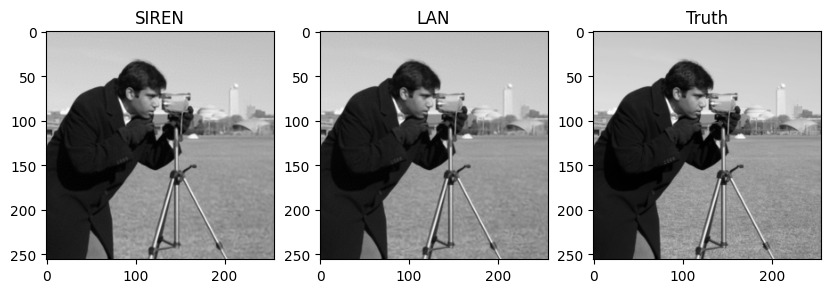

Step 3500, SIREN loss 0.000526
Step 3500, LAN loss 0.000503


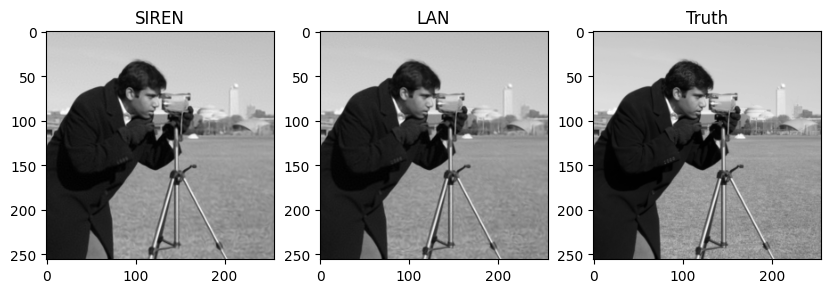

Step 3600, SIREN loss 0.000522
Step 3600, LAN loss 0.000424


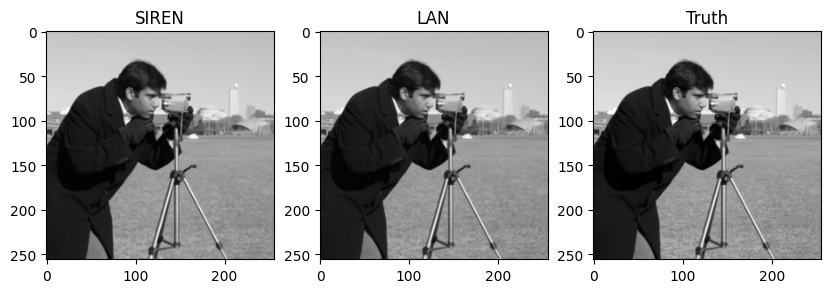

Step 3700, SIREN loss 0.000478
Step 3700, LAN loss 0.000437


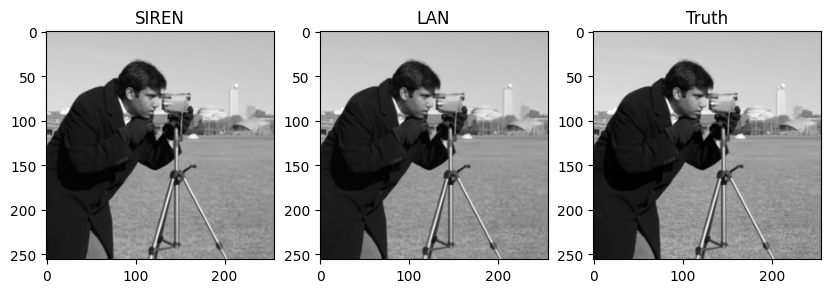

Step 3800, SIREN loss 0.000482
Step 3800, LAN loss 0.000433


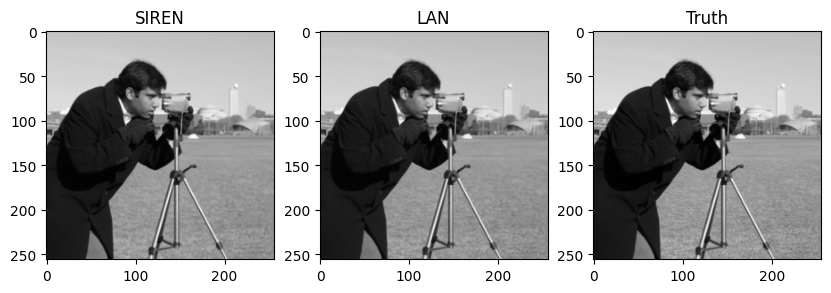

Step 3900, SIREN loss 0.000480
Step 3900, LAN loss 0.000422


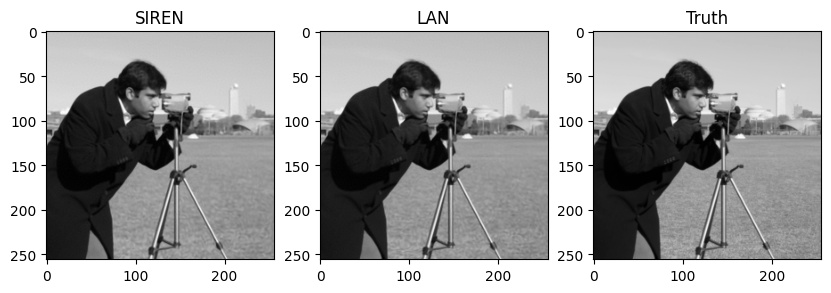

Step 4000, SIREN loss 0.000457
Step 4000, LAN loss 0.000383


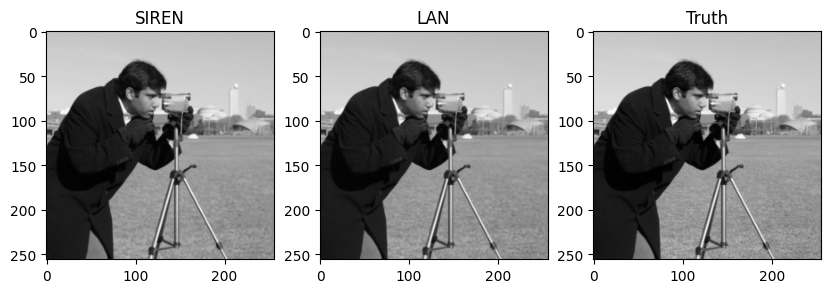

Step 4100, SIREN loss 0.000471
Step 4100, LAN loss 0.000368


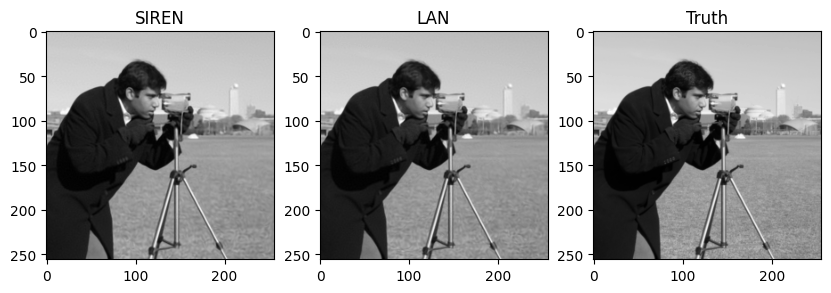

Step 4200, SIREN loss 0.000446
Step 4200, LAN loss 0.000381


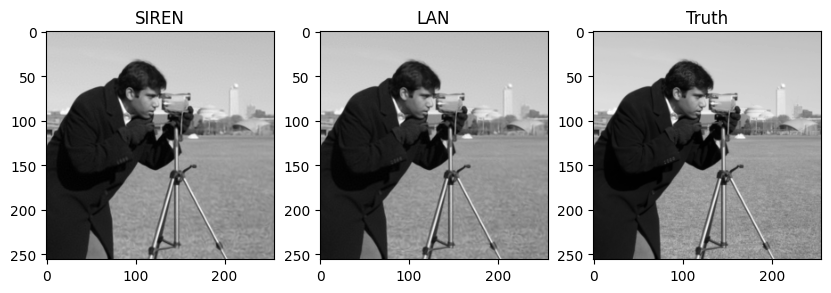

Step 4300, SIREN loss 0.000441
Step 4300, LAN loss 0.000377


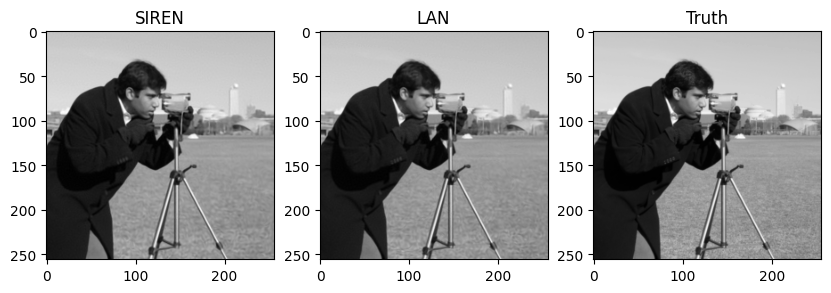

Step 4400, SIREN loss 0.000427
Step 4400, LAN loss 0.000372


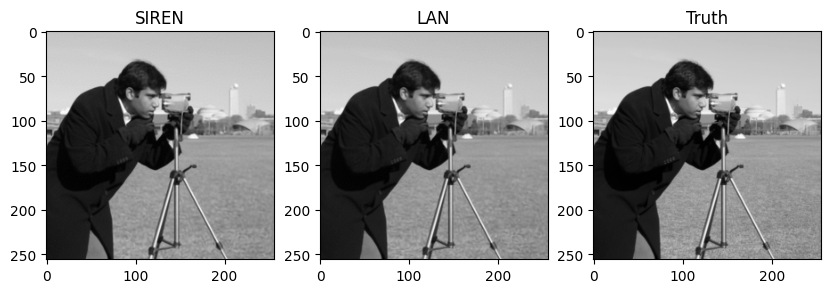

Step 4500, SIREN loss 0.000417
Step 4500, LAN loss 0.000353


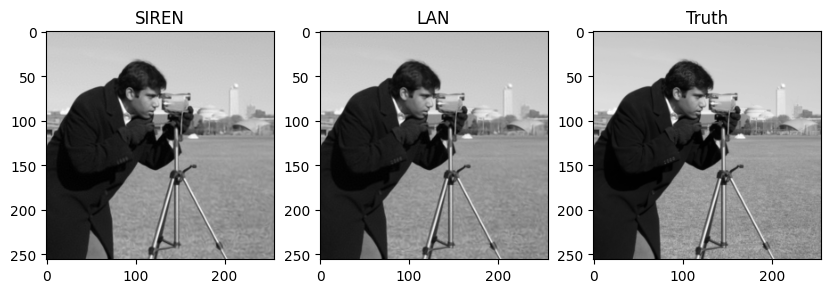

Step 4600, SIREN loss 0.000416
Step 4600, LAN loss 0.000362


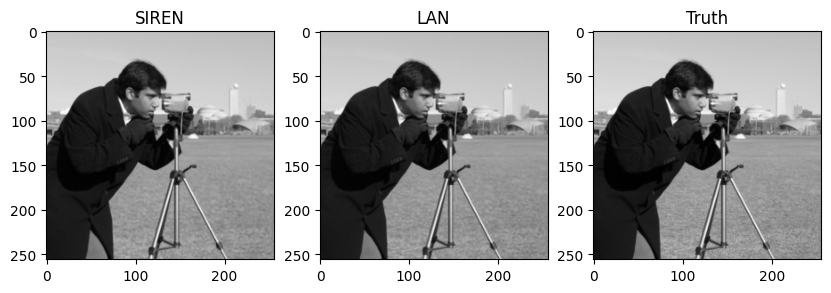

Step 4700, SIREN loss 0.000424
Step 4700, LAN loss 0.000331


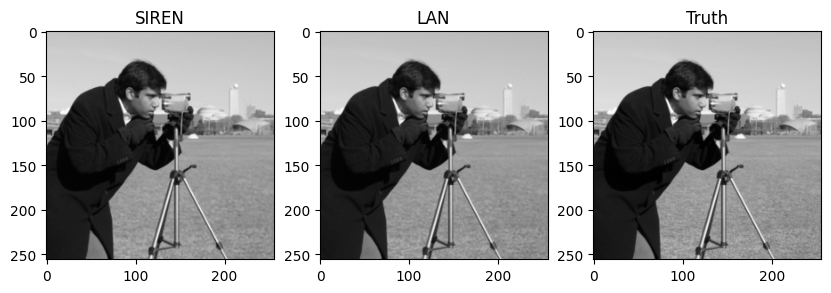

Step 4800, SIREN loss 0.000392
Step 4800, LAN loss 0.000312


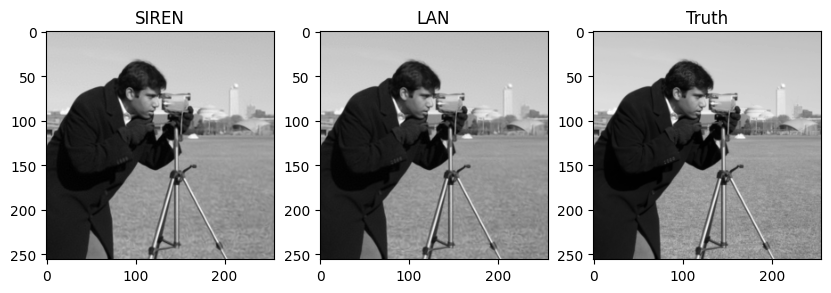

Step 4900, SIREN loss 0.000390
Step 4900, LAN loss 0.000340


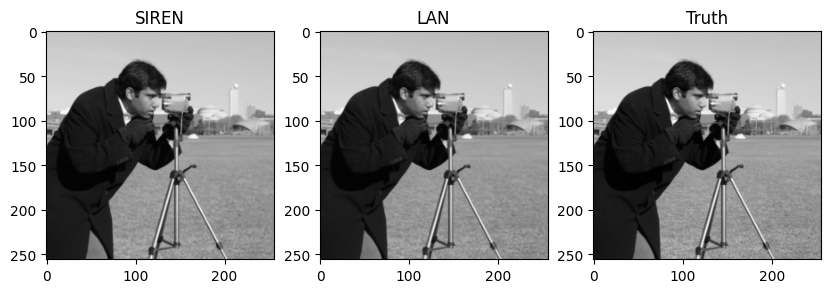

Step 5000, SIREN loss 0.000376
Step 5000, LAN loss 0.000319


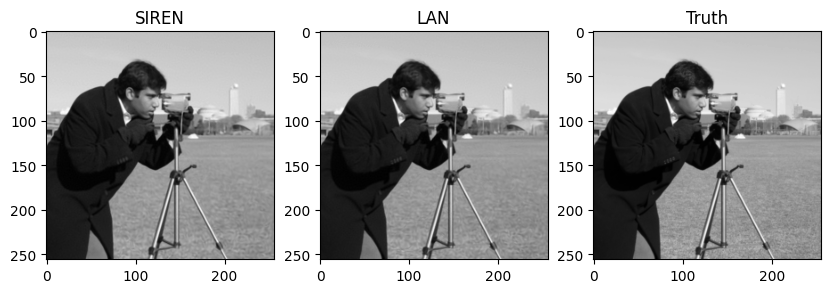

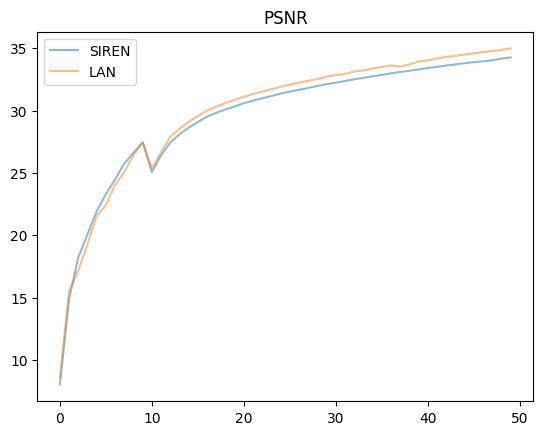

In [52]:
img = get_cameraman_tensor(sidelength)

full_data_input = get_mgrid(sidelength, 2)
full_data_target = img.permute(1, 2, 0).view(-1, 1)
models_dict = {'SIREN': img_siren, 'LAN': img_lan}
dataloader = dataloader
batch_size_infer = 4096
grad_accumulation = True
# grad_accumulation = True
total_steps = 5000
steps_til_summary = 100
lrs = [1e-3, 1e-4]
early = True
switch = 1000
plot_img = True
sidelength = 256
seed=SEED

global_outputs, psnr = train_compare_siren_lan(full_data_input,
                            full_data_target,
                            models_dict,
                            dataloader,
                            batch_size_infer,
                            grad_accumulation = grad_accumulation,
                            total_steps = total_steps, 
                            steps_til_summary = steps_til_summary, 
                            lrs = lrs, 
                            early = early,
                            switch = switch,
                            plot_img = plot_img,
                            sidelength = sidelength,
                            device=device, 
                            seed=seed)

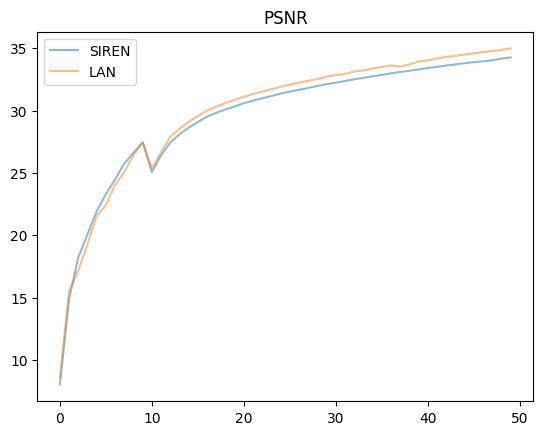

In [53]:
plot_loss(psnr, 'PSNR')